### Begin by importing relevant packages.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import requests
from scipy.stats import chisquare
import re
from sklearn.preprocessing import OneHotEncoder

In [2]:
filepath = r'C:\Users\casti\OneDrive\Documents\A Springboard\Capstone 2 - Global Terrorism\data\interim\gtdus_clean.csv'

df = pd.read_csv(filepath)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3147 entries, 0 to 3146
Data columns (total 45 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   eventid           3147 non-null   int64  
 1   date              3147 non-null   object 
 2   extended          3147 non-null   int64  
 3   provstate         3147 non-null   object 
 4   city              3147 non-null   object 
 5   latitude          3147 non-null   float64
 6   longitude         3147 non-null   float64
 7   specificity       3147 non-null   float64
 8   vicinity          3147 non-null   int64  
 9   summary           2098 non-null   object 
 10  crit1             3147 non-null   int64  
 11  crit2             3147 non-null   int64  
 12  crit3             3147 non-null   int64  
 13  success           3147 non-null   int64  
 14  suicide           3147 non-null   int64  
 15  attacktype1_txt   3147 non-null   object 
 16  targtype1_txt     3147 non-null   object 


### Since New York City is such a large city, I want to consolidate any use of "New York" to "New York City" to capture all info.

In [4]:
names = []
for name in df.city:
        if name == 'New York':
            names.append('New York City')
        else :
            names.append(name)

df.city = names
df.city.unique()

array(['Cairo', 'Oakland', 'Madison', 'Baraboo', 'Denver', 'Detroit',
       'Rio Piedras', 'New York City', 'Rio Grande', 'Seattle',
       'Champaign', 'Jersey City', 'South Sioux City', 'West Point',
       'Norwalk', 'Coral Gables', 'Portland', 'Akron', 'Dorado',
       'Carolina', 'Boston', 'Whitewater', 'Batavia', 'Ypsilanti',
       'Berkeley', 'Eugene', 'San Francisco', 'Buckeystown', 'Covington',
       'Cleveland', 'Vallejo', 'Hartford', 'Ithaca', 'Prairie du Sac',
       'Tucson', 'Boulder', 'Colorado Springs', 'Martinez', 'San Juan',
       'Ashville', 'Bridgeport', 'Albuquerque', 'Bel Air', 'Cambridge',
       'Chicago', 'Appleton', 'Long Beach', 'Billings', 'San Bernardino',
       'Los Angeles', 'Lockland', 'Washington', 'Orlando', 'Richmond',
       'Biggsville', 'Fort Benning', 'East Lansing', 'Houston', 'Pullman',
       'Trona', 'Lawrence', 'Baxter Springs', 'East St. Louis',
       'San Diego', 'Freeport', 'Kansas City', 'Milwaukee', 'Redlands',
       'Aguada', 'Pa

In [5]:
df.describe(include='all')

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
count,3.147000e+03,3147,3147.000000,3147,3147,3147.000000,3147.000000,3147.000000,3147.000000,2098,...,3147.000000,3147,1319,3147,3147,3147.000000,3147.000000,3147.000000,3147.000000,567
unique,NaN,2226,NaN,54,827,NaN,NaN,NaN,NaN,2078,...,NaN,5,1261,1271,15,NaN,NaN,NaN,NaN,191
top,NaN,1971-08-22,NaN,California,New York City,NaN,NaN,NaN,NaN,"05/04/2002: Between the dates of May 3-7, 2002...",...,NaN,Minor (likely < $1 million),This was one in a series of 11 incidents (1025...,Unspecified,Hewitt Project,NaN,NaN,NaN,NaN,"197310200002, 197310220003, 197310290003, 1973..."
freq,NaN,10,NaN,634,482,NaN,NaN,NaN,NaN,6,...,NaN,1450,10,1049,1005,NaN,NaN,NaN,NaN,20
mean,1.987386e+11,NaN,0.005084,NaN,NaN,36.714734,-92.176107,1.018748,0.022561,NaN,...,0.036543,NaN,NaN,NaN,NaN,-4.870035,-4.821417,0.072450,-4.446139,NaN
std,1.689762e+09,NaN,0.071133,NaN,NaN,7.521571,20.457583,0.232386,0.148523,NaN,...,1.223680,NaN,NaN,NaN,NaN,4.602296,4.661513,0.569818,4.760895,NaN
min,1.970010e+11,NaN,0.000000,NaN,NaN,-84.671596,-158.081142,1.000000,0.000000,NaN,...,0.000000,NaN,NaN,NaN,NaN,-9.000000,-9.000000,-9.000000,-9.000000,NaN
25%,1.973012e+11,NaN,0.000000,NaN,NaN,34.097866,-117.411102,1.000000,0.000000,NaN,...,0.000000,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,-9.000000,NaN
50%,1.981063e+11,NaN,0.000000,NaN,NaN,38.908642,-85.512338,1.000000,0.000000,NaN,...,0.000000,NaN,NaN,NaN,NaN,-9.000000,-9.000000,0.000000,-9.000000,NaN
75%,1.999116e+11,NaN,0.000000,NaN,NaN,40.697132,-73.931351,1.000000,0.000000,NaN,...,0.000000,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000,0.000000,NaN


### A brief description of columns reveals some interesting things. Most notably, I can tell that I'll need to engineer some numeric features based on categories, extraneous info, and potentially NLP from descriptions. Secondly, it looks like I have at least one longitude value in my latitude column and vice versa. 

### Let's begin with the lat/lon issue, then move on to loading and adding some population data. Then I'll visualize distributions and interactions.

In [6]:
df[df.latitude.astype(str).str.startswith('-')]

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
3132,202103160007,2021-03-16,0,Georgia,Acworth,-84.671596,34.056548,1.0,1,03/16/2021: An assailant opened fire at Young'...,...,0,Unspecified,The victims included Paul Andre Michels and El...,"""What we know about Robert Aaron Long, the sus...",START Primary Collection,-9,-9,1,1,"202103160007, 202103160008, 202103160009"


### Found it! This should be an easy swap.

In [7]:
df.loc[df['eventid'] == 202103160007, ['latitude','longitude']] = df.loc[df['eventid'] == 202103160007, ['longitude','latitude']].values
df.loc[df['eventid'] == 202103160007, :]

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
3132,202103160007,2021-03-16,0,Georgia,Acworth,34.056548,-84.671596,1.0,1,03/16/2021: An assailant opened fire at Young'...,...,0,Unspecified,The victims included Paul Andre Michels and El...,"""What we know about Robert Aaron Long, the sus...",START Primary Collection,-9,-9,1,1,"202103160007, 202103160008, 202103160009"


In [8]:
df.describe()

,eventid,extended,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,success,...,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,3.147000e+03,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,...,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000,3147.000000
mean,1.987386e+11,0.005084,36.752462,-92.213835,1.018748,0.022561,0.981570,0.981570,0.987925,0.825548,...,1.255799,1.176676,0.028916,8.429298,0.968224,0.036543,-4.870035,-4.821417,0.072450,-4.446139
std,1.689762e+09,0.071133,7.203558,20.333817,0.232386,0.148523,0.134523,0.134523,0.109238,0.379558,...,35.244947,34.201990,0.238111,275.215310,18.301762,1.223680,4.602296,4.661513,0.569818,4.760895
min,1.970010e+11,0.000000,0.000000,-158.081142,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.973012e+11,0.000000,34.097866,-117.411102,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,1.981063e+11,0.000000,38.908642,-85.512338,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,0.000000,-9.000000
75%,1.999116e+11,0.000000,40.697132,-73.931351,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2.021063e+11,1.000000,64.837778,0.000000,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1385.000000,1361.000000,5.000000,10878.000000,751.000000,68.000000,1.000000,1.000000,1.000000,1.000000


### Looks like I missed some more weird lat/long issues. I need to fix or remove the lat of 0 and long of -158, as those are not in the continental US.

In [9]:
df[df['latitude'].astype(str).str.startswith('0')].head()

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
1084,197601010002,1976-01-01,0,Unknown,Unknown,0.0,0.0,5.0,0,NaN,...,0,Unspecified,NaN,Unspecified,CBRN Global Chronology,-9,-9,0,-9,NaN


In [10]:
df.drop([1084], inplace=True)

In [11]:
df[df['longitude'].astype(str).str.startswith('-158')].head()

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
3048,202005260018,2020-05-26,0,Hawaii,Kalaeloa,21.321632,-158.081142,1.0,0,05/26/2020: Assailants set fire to offices ins...,...,0,Minor (likely < $1 million),NaN,"""Kalaeloa church fire being investigated as ar...",START Primary Collection,-9,-9,0,-9,NaN


### This appears to be Hawaii. I should probably narrow this analysis down to continental US.

In [12]:
df.provstate.sort_values().unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Delaware', 'District of Columbia',
       'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
       'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
       'New Jersey', 'New Mexico', 'New York', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
       'Puerto Rico', 'Rhode Island', 'South Carolina', 'South Dakota',
       'Tennessee', 'Texas', 'U.S. Virgin Islands', 'Utah', 'Vermont',
       'Virginia', 'Washington', 'West Virginia', 'Wisconsin', 'Wyoming'],
      dtype=object)

In [13]:
df[df['provstate'].isin(['Alaska','Hawaii','Puerto Rico','U.S. Virgin Islands'])]

,eventid,date,extended,provstate,city,latitude,longitude,specificity,vicinity,summary,...,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
7,197001090002,1970-01-09,0,Puerto Rico,Rio Piedras,18.386932,-66.061127,1.0,0,1/9/1970: The Armed Commandos of Liberation c...,...,0,Major (likely >= $1 million but < $1 billion),The fire began at 8:30 PM. The Armed Commandos...,Committee on the Judiciary United States Sena...,Hewitt Project,0,0,0,0,NaN
9,197001120002,1970-01-12,0,Puerto Rico,Rio Grande,18.379998,-65.830948,1.0,0,1/12/1970: Unknown perpetrators detonated a bo...,...,0,Unknown,NaN,Committee on the Judiciary United States Sena...,Hewitt Project,-9,-9,0,-9,NaN
35,197002060004,1970-02-06,0,Puerto Rico,Dorado,18.460791,-66.264884,1.0,0,"2/6/1970: In a series of related events, the A...",...,0,Unknown,Part of a multiple attack with 197002060005 an...,Committee on Government Operations United Stat...,Hewitt Project,0,1,0,1,"197002060004, 197002060005, 197002060006"
36,197002060005,1970-02-06,0,Puerto Rico,Rio Piedras,18.386932,-66.061127,1.0,0,"2/6/1970: In a series of related events, the A...",...,0,Unknown,Part of a multiple attack with 197002060004 an...,Committee on Government Operations United Stat...,Hewitt Project,0,1,0,1,"197002060004, 197002060005, 197002060006"
37,197002060006,1970-02-06,0,Puerto Rico,Carolina,18.441963,-66.026316,1.0,0,"2/6/1970: In a series of related events, the A...",...,0,Unknown,Part of a multiple attack with 197002060004 an...,Committee on Government Operations United Stat...,Hewitt Project,0,1,0,1,"197002060004, 197002060005, 197002060006"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2817,201702280022,2017-02-28,0,U.S. Virgin Islands,Charlotte Amalie,18.343232,-64.931757,1.0,0,02/28/2017: An assailant threw firebombs at th...,...,0,Minor (likely < $1 million),There is doubt that this incident meets terror...,"""Federal offices in St. Thomas firebombed; sus...",START Primary Collection,-9,-9,1,1,"201702280022, 201702280023, 201702280024"
2818,201702280023,2017-02-28,0,U.S. Virgin Islands,Charlotte Amalie,18.343232,-64.931757,1.0,0,02/28/2017: An assailant threw firebombs at th...,...,0,Unknown,There is doubt that this incident meets terror...,"""Federal offices in St. Thomas firebombed; sus...",START Primary Collection,-9,-9,1,1,"201702280022, 201702280023, 201702280024"
2819,201702280024,2017-02-28,0,U.S. Virgin Islands,Charlotte Amalie West,18.338017,-64.960540,1.0,0,02/28/2017: An assailant threw firebombs at a ...,...,0,Unknown,There is doubt that this incident meets terror...,"""Federal offices in St. Thomas firebombed; sus...",START Primary Collection,-9,-9,1,1,"201702280022, 201702280023, 201702280024"
2862,201710280037,2017-10-28,0,Puerto Rico,San Juan,18.385444,-66.056706,1.0,0,10/28/2017: Assailants threw incendiary device...,...,0,Minor (likely < $1 million),There is doubt that this incident meets terror...,"""They throw incendiary bombs to disco in Santu...",START Primary Collection,-9,-9,0,-9,NaN


In [14]:
df = df[~df['provstate'].isin(['Alaska','Hawaii','Puerto Rico','U.S. Virgin Islands'])]

In [15]:
df.describe()

,eventid,extended,latitude,longitude,specificity,vicinity,crit1,crit2,crit3,success,...,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
count,2.889000e+03,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,...,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000,2889.000000
mean,1.987971e+11,0.005192,38.382382,-94.374570,1.008654,0.021461,0.980270,0.981655,0.992385,0.831083,...,1.359640,1.277605,0.030807,9.161648,1.043960,0.039806,-5.109034,-5.053306,0.070959,-4.688127
std,1.734813e+09,0.071881,4.819902,19.374036,0.149773,0.144939,0.139095,0.134220,0.086947,0.374743,...,36.783625,35.695190,0.245639,287.233926,19.098116,1.277119,4.573221,4.644114,0.588572,4.759813
min,1.970010e+11,0.000000,25.699073,-124.238217,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,-9.000000,-9.000000
25%,1.972060e+11,0.000000,35.207255,-118.167056,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,0.000000,-9.000000
50%,1.981101e+11,0.000000,39.176086,-87.681229,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,-9.000000,0.000000,-9.000000
75%,2.001052e+11,0.000000,40.759505,-76.073792,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,2.021063e+11,1.000000,48.752350,-69.779646,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1385.000000,1361.000000,5.000000,10878.000000,751.000000,68.000000,1.000000,1.000000,1.000000,1.000000


In [16]:
df.rename(columns={'provstate':'state'}, inplace=True)
df.state.sort_values().unique()

array(['Alabama', 'Arizona', 'Arkansas', 'California', 'Colorado',
       'Connecticut', 'Delaware', 'District of Columbia', 'Florida',
       'Georgia', 'Idaho', 'Illinois', 'Indiana', 'Iowa', 'Kansas',
       'Kentucky', 'Louisiana', 'Maine', 'Maryland', 'Massachusetts',
       'Michigan', 'Minnesota', 'Mississippi', 'Missouri', 'Montana',
       'Nebraska', 'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico',
       'New York', 'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma',
       'Oregon', 'Pennsylvania', 'Rhode Island', 'South Carolina',
       'South Dakota', 'Tennessee', 'Texas', 'Utah', 'Vermont',
       'Virginia', 'Washington', 'West Virginia', 'Wisconsin', 'Wyoming'],
      dtype=object)

### Looks like my coordinates contain the continental US! 

### Before moving on to distributions and interactions, I'll load some population data taken from an open source on Github. This data was orginally scraped from a population database and loaded into a txt file. 

In [17]:
filepath2 = r'C:\Users\casti\OneDrive\Documents\A Springboard\Capstone 2 - Global Terrorism\data\interim\citypop.txt'
citypops = pd.read_csv(filepath2, skiprows=3, nrows = 1000)
citypops.city.replace(to_replace='New York',value='New York City',inplace=True)
print(citypops.head())
print(citypops.tail())

   rank           city         state  population 2000-2013 growth
0     1  New York City      New York     8405837             4.8%
1     2    Los Angeles    California     3884307             4.8%
2     3        Chicago      Illinois     2718782            -6.1%
3     4        Houston         Texas     2195914            11.0%
4     5   Philadelphia  Pennsylvania     1553165             2.6%
     rank          city      state  population 2000-2013 growth
995   996       Weslaco      Texas       37093            28.8%
996   997        Keizer     Oregon       37064            14.4%
997   998  Spanish Fork       Utah       36956            78.1%
998   999        Beloit  Wisconsin       36888             2.9%
999  1000   Panama City    Florida       36877             0.1%


### This dataset includes 1000 cities. How many are missing compared to the entries in my df?

In [18]:
missing = set(df.city) - set(citypops.city)
print(len(missing))
df[df.city.isin(missing)].info()

393
<class 'pandas.core.frame.DataFrame'>
Index: 550 entries, 0 to 3146
Data columns (total 45 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   eventid           550 non-null    int64  
 1   date              550 non-null    object 
 2   extended          550 non-null    int64  
 3   state             550 non-null    object 
 4   city              550 non-null    object 
 5   latitude          550 non-null    float64
 6   longitude         550 non-null    float64
 7   specificity       550 non-null    float64
 8   vicinity          550 non-null    int64  
 9   summary           454 non-null    object 
 10  crit1             550 non-null    int64  
 11  crit2             550 non-null    int64  
 12  crit3             550 non-null    int64  
 13  success           550 non-null    int64  
 14  suicide           550 non-null    int64  
 15  attacktype1_txt   550 non-null    object 
 16  targtype1_txt     550 non-null    object 
 1

In [19]:
missing

{'Acworth',
 'Afton',
 'Alamogordo',
 'Albertville',
 'Albion',
 'Altadena',
 'Alto',
 'Alton',
 'Amherst',
 'Anamosa',
 'Andrews',
 'Aptos',
 'Arcata',
 'Arivaca',
 'Asbury',
 'Ashland',
 'Ashville',
 'Astoria',
 'Athens',
 'Atherton',
 'Atkins',
 'Augusta',
 'Axton',
 'Aztec',
 "Bailey's Crossroads",
 'Baraboo',
 'Barnegat',
 'Batavia',
 'Baxter Springs',
 'Bedford Park',
 'Bel Air',
 'Belmont',
 'Ben Lomond',
 'Berlin',
 'Bessemer',
 'Bethesda',
 'Beverly Hills',
 'Biggsville',
 'Blooming Grove',
 'Bluefield',
 'Boise',
 'Bonners Ferry',
 'Boulder City',
 'Brainerd',
 'Braintree',
 'Brewster',
 'Bridgeton',
 'Brighton',
 'Brookline',
 'Brooklyn Center',
 'Brunswick',
 'Buckeystown',
 'Buena Vista County',
 'Bullard',
 'Bunkerville',
 'Burlingame',
 'Burns',
 'Cairo',
 'Camano',
 'Campbelltown',
 'Capitol Heights',
 'Capitola',
 'Carlisle',
 'Carmichael',
 'Century',
 'Chantilly',
 'Chappaqua',
 'Cherry Hill',
 'Chester',
 'Claremont',
 'Clatskanie',
 'Cle Elum',
 'Cloverdale',
 "Coe

### I'm missing 393 city populations. But, I can tell a few things just from glancing at this list.

### First, there is a typo in 'MIami' in my df. Second, some cities may be listed as "Saint..." or "St...", or "Mount.." or "Mt...". I'll correct these to long form in both datasets for consistency. I also see an oddball: Nashville-Davidson for Nashville.

In [20]:
df.city.replace('MIami','Miami',inplace=True)
citypops.city.replace(to_replace='New York', value='New York City',inplace=True)
citypops.city.replace(to_replace=r'^St\.',value='Saint',regex=True, inplace=True)
df.city.replace(to_replace=r'^St\.',value='Saint',regex=True, inplace=True)
citypops.city.replace(to_replace=r'^Mt\.',value='Mount',regex=True, inplace=True)
df.city.replace(to_replace=r'^Mt\.',value='Mount',regex=True, inplace=True)
citypops.city.replace(to_replace='Nashville-Davidson',value='Nashville',inplace=True)

In [21]:
missing = set(df.city) - set(citypops.city)
print(len(missing))
print(df[df.city.isin(missing)].info())
df[df.city.isin(missing)].city.value_counts().head()

391
<class 'pandas.core.frame.DataFrame'>
Index: 542 entries, 0 to 3146
Data columns (total 45 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   eventid           542 non-null    int64  
 1   date              542 non-null    object 
 2   extended          542 non-null    int64  
 3   state             542 non-null    object 
 4   city              542 non-null    object 
 5   latitude          542 non-null    float64
 6   longitude         542 non-null    float64
 7   specificity       542 non-null    float64
 8   vicinity          542 non-null    int64  
 9   summary           449 non-null    object 
 10  crit1             542 non-null    int64  
 11  crit2             542 non-null    int64  
 12  crit3             542 non-null    int64  
 13  success           542 non-null    int64  
 14  suicide           542 non-null    int64  
 15  attacktype1_txt   542 non-null    object 
 16  targtype1_txt     542 non-null    object 
 1

city
Cairo               12
Oxford               7
South Sioux City     7
Trona                6
Coeur D'Alene        5
Name: count, dtype: int64

### My corrections were mildly helpful. I'm still missing 391 city populations. However, none of my missing cities record more than 12 incidents. Even though it amounts to 542 incidents, I will proceed without these city populations. As the analysis progresses, I will have to either remove or categorize these cities some other way - for now, I can still glean other info from the data provided.

In [22]:
citypops_trim = citypops[['city','state','population']]
citypops_trim

,city,state,population
0,New York City,New York,8405837
1,Los Angeles,California,3884307
2,Chicago,Illinois,2718782
3,Houston,Texas,2195914
4,Philadelphia,Pennsylvania,1553165
...,...,...,...
995,Weslaco,Texas,37093
996,Keizer,Oregon,37064
997,Spanish Fork,Utah,36956
998,Beloit,Wisconsin,36888


In [23]:
filepath3 = r'C:\Users\casti\OneDrive\Documents\A Springboard\Capstone 2 - Global Terrorism\data\raw\census2010states.csv'
censusdf = pd.read_csv(filepath3,encoding='utf-8')
censusdf.head()

,Label (Grouping),Alabama!!Total population!!Estimate,Alabama!!Total population!!Margin of Error,Alaska!!Total population!!Estimate,Alaska!!Total population!!Margin of Error,Arizona!!Total population!!Estimate,Arizona!!Total population!!Margin of Error,Arkansas!!Total population!!Estimate,Arkansas!!Total population!!Margin of Error,California!!Total population!!Estimate,...,Virginia!!Total population!!Estimate,Virginia!!Total population!!Margin of Error,Washington!!Total population!!Estimate,Washington!!Total population!!Margin of Error,West Virginia!!Total population!!Estimate,West Virginia!!Total population!!Margin of Error,Wisconsin!!Total population!!Estimate,Wisconsin!!Total population!!Margin of Error,Wyoming!!Total population!!Estimate,Wyoming!!Total population!!Margin of Error
0,TOTAL NUMBER OF RACES REPORTED,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Total population,"4,785,298",*****,"713,985",*****,"6,413,737",*****,"2,921,606",*****,"37,349,363",...,"8,024,617",*****,"6,744,496",*****,"1,853,973",*****,"5,691,047",*****,"564,460",*****
2,One race,98.6%,±0.1,93.0%,±0.6,97.4%,±0.2,98.3%,±0.1,95.8%,...,97.3%,±0.1,95.5%,±0.2,98.0%,±0.2,97.9%,±0.1,97.3%,±0.4
3,Two races,1.3%,±0.1,6.3%,±0.6,2.5%,±0.2,1.6%,±0.1,3.8%,...,2.5%,±0.1,4.1%,±0.2,1.8%,±0.2,2.0%,±0.1,2.7%,±0.4
4,Three races,0.1%,±0.1,0.7%,±0.2,0.1%,±0.1,0.1%,±0.1,0.3%,...,0.2%,±0.1,0.4%,±0.1,0.1%,±0.1,0.2%,±0.1,0.0%,±0.1


In [24]:
newnames = []
for column_name in list(censusdf.columns):
    result = re.search(r'^(.*?)!', column_name)
    if result:
        extracted_text = result.group(1)
        if extracted_text in newnames:
            newnames.append(f'{extracted_text} MOE')
        else:  
            newnames.append(extracted_text)
    else:
        newnames.append(column_name)

newnames[0] = 'group'
censusdf.columns=newnames

In [76]:
pd.set_option('display.max_columns', None)
censusdf.T.head()
censusdf_t = censusdf.T
rowvals = []
for x in censusdf_t.iloc[0,:] :
    rowvals.append(x.replace('\xa0',''))
censusdf_t.columns = rowvals
censusdf_t.drop(censusdf_t.index[0], inplace=True)
censusdf_t.reset_index(inplace=True)
censusdf_t.rename(columns={'index':'state'},inplace=True)
for index, row in censusdf_t.iterrows():
    if row.str.contains('MOE').any():
        censusdf_t.drop(index,inplace=True)

for i in range(len(censusdf_t.columns) - 1):
    # Check if the column values contain '%' using string methods or regular expressions
    if censusdf_t.iloc[:,i].dtype == 'object' and censusdf_t.iloc[:,i].str.contains('%').any():
        if censusdf_t.iloc[:,i].str.contains('N').any():
            censusdf_t.iloc[:,i] = censusdf_t.iloc[:,i].str.replace('N','0', regex=True)
        censusdf_t.iloc[:,i] = censusdf_t.iloc[:,i].str.replace('%', '', regex=True)
        censusdf_t.iloc[:,i] = censusdf_t.iloc[:,i].astype(float)
        #censusdf_t.iloc[:,i] = censusdf_t.iloc[:,i].replace('0.0',np.median(censusdf_t.iloc[:,i]))
    elif censusdf_t.iloc[:,i].dtype == 'object' and censusdf_t.iloc[:,i].str.contains(',').any():
        censusdf_t.iloc[:,i] = censusdf_t.iloc[:,i].str.replace(',','', regex=True).astype(int)
    

censusdf_t.head()

,state,TOTAL NUMBER OF RACES REPORTED,Total population,One race,Two races,Three races,Four or more races,SEX AND AGE,Total population,Male,Female,Under 5 years,5 to 17 years,18 to 24 years,25 to 34 years,35 to 44 years,45 to 54 years,55 to 64 years,65 to 74 years,75 years and over,Median age (years),18 years and over,21 years and over,62 years and over,65 years and over,Under 18 years,Male,Female,18 years and over,Male,Female,18 to 34 years,Male,Female,35 to 64 years,Male,Female,65 years and over,Male,Female,RELATIONSHIP,Population in households,Householder or spouse,Child,Other relatives,Nonrelatives,Unmarried partner,HOUSEHOLDS BY TYPE,Households,Family households,With own children under 18 years,Married-couple family,With own children under 18 years,"Female householder, no husband present, family",With own children under 18 years,Nonfamily households,Male householder,Living alone,Not living alone,Female householder,Living alone,Not living alone,Average household size,Average family size,MARITAL STATUS,Population 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,Male 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,Female 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,SCHOOL ENROLLMENT,Population 3 years and over enrolled in school,"Nursery school, preschool",Kindergarten,Elementary school (grades 1-8),High school (grades 9-12),College or graduate school,Male 3 years and over enrolled in school,Percent enrolled in kindergarten to grade 12,Percent enrolled in college or graduate school,Female 3 years and over enrolled in school,Percent enrolled in kindergarten to grade 12,Percent enrolled in college or graduate school,EDUCATIONAL ATTAINMENT,Population 25 years and over,Less than high school diploma,High school graduate (includes equivalency),Some college or associate's degree,Bachelor's degree,Graduate or professional degree,High school graduate or higher,"Male, high school graduate or higher","Female, high school graduate or higher",Bachelor's degree or higher,"Male, bachelor's degree or higher","Female, bachelor's degree or higher",FERTILITY,Women 15 to 50 years,Women 15 to 50 years who had a birth in the past 12 months,Unmarried women 15 to 50 years who had a birth in the past 12 months,As a percent of all women with a birth in the past 12 months,RESPONSIBILITY FOR GRANDCHILDREN UNDER 18 YEARS,Population 30 years and over,Living with grandchild(ren),Responsible for grandchild(ren),VETERAN STATUS,Civilian population 18 years and over,Civilian veteran,DISABILITY STATUS,Total civilian noninstitutionalized population,With a disability,Civilian noninstitutionalized population under 18 years,With a disability,Civilian noninstitutionalized population 18 to 64 years,With a disability,Civilian noninstitutionalized population 65 years and older,With a disability,RESIDENCE 1 YEAR AGO,Population 1 year and over,Same house,Different house in the U.S.,Same county,Different county,Same state,Different state,Abroad,"PLACE OF BIRTH, CITIZENSHIP STATUS AND YEAR OF ENTRY",Native,Male,Female,Foreign born,Male,Female,Foreign born; naturalized U.S. citizen,Male,Female,Foreign born; not a U.S. citizen,Male,Female,Population born outside the United States,Entered 2000 or later,Entered 1990 to 1999,Entered before 1990,WORLD REGION OF BIRTH OF FOREIGN BORN,Foreign-born population excluding population born at sea,Europe,Asia,Africa,Oceania,Latin America,Northern America,LANGUAGE SPOKEN AT HOME AND ABILITY TO SPEAK ENGLISH,Population 5 years and over,English only,Language other than English,"Speak English less than ""very well""",EMPLOYMENT STATUS,Population 16 years and over,In labor force,Civilian labor force,Employed,Unemployed,Percent of civilian labor force,Armed Forces,Not in labor force,Females 16 years and over,In labor force,Civilian labor force,Employed,Unemployed,Percent of civilian labor force,COMMUTING TO WORK,Wo

In [77]:
#censusdf_t = censusdf.astype({'Two races':'float64'})
# Using .loc indexer and copy=False parameter
#censusdf_t.loc[:, censusdf_t.columns[3]] = censusdf_t.loc[:, censusdf_t.columns[3]].astype(float, copy=False)
censusdf_t.info()
print(censusdf_t.iloc[:,3].dtype)
print(censusdf_t.iloc[:,3].astype(float).dtype)
censusdf_t.iloc[:,3] = censusdf_t.iloc[:,3].astype(float)
print(censusdf_t.iloc[:,3].dtype)
censusdf_t.loc[:, censusdf_t.columns[3]] = censusdf_t.loc[:, censusdf_t.columns[3]].astype(float, copy=False)
print(censusdf_t.iloc[:,3].dtype)
censusdf_t = censusdf_t.infer_objects()
print(censusdf_t.info())

<class 'pandas.core.frame.DataFrame'>
Index: 51 entries, 0 to 100
Columns: 341 entries, state to Median gross rent (dollars)
dtypes: object(341)
memory usage: 136.3+ KB
object
float64
object
object
<class 'pandas.core.frame.DataFrame'>
Index: 51 entries, 0 to 100
Columns: 341 entries, state to Median gross rent (dollars)
dtypes: float64(258), int64(74), object(9)
memory usage: 136.3+ KB
None


In [45]:
dfst = pd.DataFrame(df.state.value_counts())
dfst.columns = ['total_incidents_state']
dfst.head()

,total_incidents_state
state,
California,634
New York,545
Florida,177
Washington,119
Illinois,115


In [78]:
dfs = pd.DataFrame(df.groupby(['state', 'targtype1_txt']).size().reset_index(name='counts')) \
                    .pivot(index='state', columns='targtype1_txt', values='counts').fillna(0)
dfs = dfs.div(dfs.sum(axis=1), axis=0)
dfa = pd.DataFrame(df.groupby(['state', 'attacktype1_txt']).size().reset_index(name='counts')) \
                    .pivot(index='state', columns='attacktype1_txt', values='counts').fillna(0)
dfa = dfa.div(dfa.sum(axis=1), axis=0)
dfsa = dfs.merge(dfa, on='state', how='left')
dfstm = dfsa.merge(dfst, on='state', how='left')
dfcm = dfstm.merge(censusdf_t, on='state', how='left')
dfcm.set_index('state', inplace=True)
#newcols = [f'{x} [{i}]' for i,x in enumerate(list(dfcm.columns))]
#dfcm.columns=newcols
dfcm['incidents_per_100k_state'] = 100000 * dfcm['total_incidents_state']/dfcm.iloc[:,33].replace(',', '', regex=True).astype('int')
dfcm.head()

C:\Users\casti\AppData\Local\Temp\ipykernel_2060\3322418060.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dfcm = dfstm.merge(censusdf_t, on='state', how='left')
C:\Users\casti\AppData\Local\Temp\ipykernel_2060\3322418060.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dfcm['incidents_per_100k_state'] = 100000 * dfcm['total_incidents_state']/dfcm.iloc[:,33].replace(',', '', regex=True).astype('int')


,Abortion Related,Airports & Aircraft,Business,Educational Institution,Food or Water Supply,Government (Diplomatic),Government (General),Journalists & Media,Maritime,Military,NGO,Other,Police,Private Citizens & Property,Religious Figures/Institutions,Telecommunication,Terrorists/Non-State Militia,Tourists,Transportation,Unknown_x,Utilities,Violent Political Party,Armed Assault,Assassination,Bombing/Explosion,Facility/Infrastructure Attack,Hijacking,Hostage Taking (Barricade Incident),Hostage Taking (Kidnapping),Unarmed Assault,Unknown_y,total_incidents_state,TOTAL NUMBER OF RACES REPORTED,Total population,One race,Two races,Three races,Four or more races,SEX AND AGE,Total population,Male,Female,Under 5 years,5 to 17 years,18 to 24 years,25 to 34 years,35 to 44 years,45 to 54 years,55 to 64 years,65 to 74 years,75 years and over,Median age (years),18 years and over,21 years and over,62 years and over,65 years and over,Under 18 years,Male,Female,18 years and over,Male,Female,18 to 34 years,Male,Female,35 to 64 years,Male,Female,65 years and over,Male,Female,RELATIONSHIP,Population in households,Householder or spouse,Child,Other relatives,Nonrelatives,Unmarried partner,HOUSEHOLDS BY TYPE,Households,Family households,With own children under 18 years,Married-couple family,With own children under 18 years,"Female householder, no husband present, family",With own children under 18 years,Nonfamily households,Male householder,Living alone,Not living alone,Female householder,Living alone,Not living alone,Average household size,Average family size,MARITAL STATUS,Population 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,Male 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,Female 15 years and over,"Now married, except separated",Widowed,Divorced,Separated,Never married,SCHOOL ENROLLMENT,Population 3 years and over enrolled in school,"Nursery school, preschool",Kindergarten,Elementary school (grades 1-8),High school (grades 9-12),College or graduate school,Male 3 years and over enrolled in school,Percent enrolled in kindergarten to grade 12,Percent enrolled in college or graduate school,Female 3 years and over enrolled in school,Percent enrolled in kindergarten to grade 12,Percent enrolled in college or graduate school,EDUCATIONAL ATTAINMENT,Population 25 years and over,Less than high school diploma,High school graduate (includes equivalency),Some college or associate's degree,Bachelor's degree,Graduate or professional degree,High school graduate or higher,"Male, high school graduate or higher","Female, high school graduate or higher",Bachelor's degree or higher,"Male, bachelor's degree or higher","Female, bachelor's degree or higher",FERTILITY,Women 15 to 50 years,Women 15 to 50 years who had a birth in the past 12 months,Unmarried women 15 to 50 years who had a birth in the past 12 months,As a percent of all women with a birth in the past 12 months,RESPONSIBILITY FOR GRANDCHILDREN UNDER 18 YEARS,Population 30 years and over,Living with grandchild(ren),Responsible for grandchild(ren),VETERAN STATUS,Civilian population 18 years and over,Civilian veteran,DISABILITY STATUS,Total civilian noninstitutionalized population,With a disability,Civilian noninstitutionalized population under 18 years,With a disability,Civilian noninstitutionalized population 18 to 64 years,With a disability,Civilian noninstitutionalized population 65 years and older,With a disability,RESIDENCE 1 YEAR AGO,Population 1 year and over,Same house,Different house in the U.S.,Same county,Different county,Same state,Different state,Abroad,"PLACE OF BIRTH, CITIZENSHIP STATUS AND YEAR OF ENTRY",Native,Male,Female,Foreign born,Male,Female,Foreign born; naturalized U.S. citizen,Male,Female,Foreign born; not a U.S. citizen,Male,Female,Population born outside the United States,Entered 2000 or later,Entered 1990 to 1999,Entered before 1990,WORLD REGION OF BIRTH OF FOREIGN BORN,Foreign-born populat

In [79]:
dfcm.info()

<class 'pandas.core.frame.DataFrame'>
Index: 49 entries, Alabama to Wyoming
Columns: 373 entries, Abortion Related to incidents_per_100k_state
dtypes: float64(290), int64(75), object(8)
memory usage: 143.2+ KB


In [48]:
dfp = df.merge(citypops_trim, how='left', on=['city','state'])
dfp['total_city_incidents'] = dfp.groupby('city')['eventid'].transform('size')
dfp['incidents_per_100k_city'] = 100000 * dfp['total_city_incidents'] / dfp['population']
print(df.shape)
print(dfp.shape)
print(dfcm.shape)
dfp.head()

(2889, 45)
(2889, 48)
(49, 373)


,eventid,date,extended,state,city,latitude,longitude,specificity,vicinity,summary,crit1,crit2,crit3,success,suicide,attacktype1_txt,targtype1_txt,targsubtype1_txt,corp1,target1,natlty1_txt,gname,motive,guncertain1,nperps,nperpcap,claimed,weaptype1_txt,weapsubtype1_txt,weapdetail,nkill,nkillus,nkillter,nwound,nwoundus,nwoundte,propextent_txt,addnotes,scite1,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related,population,total_city_incidents,incidents_per_100k_city
0,197001010002,1970-01-01,0,Illinois,Cairo,37.005105,-89.176269,1.0,0,1/1/1970: Unknown African American assailants ...,1,1,1,1,0,Armed Assault,Police,"Police Building (headquarters, station, school)",Cairo Police Department,Cairo Police Headquarters,United States,Black Nationalists,To protest the Cairo Illinois Police Deparment,0.0,-99,-99,0.0,Firearms,Unknown Gun Type,Several gunshots were fired.,0,0,0,0,0,0,Minor (likely < $1 million),"The Cairo Chief of Police, William Petersen, r...","""Police Chief Quits,"" Washington Post, January...",Hewitt Project,-9,-9,0,-9,NaN,NaN,12,NaN
1,197001020002,1970-01-02,0,California,Oakland,37.791927,-122.225906,1.0,0,1/2/1970: Unknown perpetrators detonated explo...,1,1,1,1,0,Bombing/Explosion,Utilities,Electricity,Pacific Gas & Electric Company,Edes Substation,United States,Unknown,Unspecified,0.0,-99,-99,0.0,Explosives,Unknown Explosive Type,NaN,0,0,0,0,0,0,Minor (likely < $1 million),"Damages were estimated to be between $20,000-$...",Committee on Government Operations United Stat...,Hewitt Project,-9,-9,0,-9,NaN,406253.0,22,5.415345
2,197001020003,1970-01-02,0,Wisconsin,Madison,43.076592,-89.412488,1.0,0,"1/2/1970: Karl Armstrong, a member of the New ...",1,1,1,1,0,Facility/Infrastructure Attack,Military,Military Recruiting Station/Academy,R.O.T.C.,"R.O.T.C. offices at University of Wisconsin, M...",United States,New Year's Gang,To protest the War in Vietnam and the draft,0.0,1,1,1.0,Incendiary,Molotov Cocktail/Petrol Bomb,Firebomb consisting of gasoline,0,0,0,0,0,0,Minor (likely < $1 million),The New Years Gang issue a communiqué to a loc...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...",Hewitt Project,0,0,0,0,NaN,243344.0,8,3.287527
3,197001030001,1970-01-03,0,Wisconsin,Madison,43.072950,-89.386694,1.0,0,"1/3/1970: Karl Armstrong, a member of the New ...",1,1,1,1,0,Facility/Infrastructure Attack,Government (General),Government Building/Facility/Office,Selective Service,Selective Service Headquarters in Madison Wisc...,United States,New Year's Gang,To protest the War in Vietnam and the draft,0.0,1,1,0.0,Incendiary,Gasoline or Alcohol,Poured gasoline on the floor and lit it with a...,0,0,0,0,0,0,Minor (likely < $1 million),"Karl Armstrong's girlfriend, Lynn Schultz, dro...",Committee on Government Operations United Stat...,Hewitt Project,0,0,0,0,NaN,243344.0,8,3.287527
4,197001050001,1970-01-01,0,Wisconsin,Baraboo,43.468500,-89.744299,1.0,0,NaN,1,1,0,0,0,Bombing/Explosion,Military,Military Barracks/Base/Headquarters/Checkpost,Unspecified,Badger Army ammo depot.,United States,"Weather Underground, Weathermen",Unspecified,0.0,0,0,Unspecified,Explosives,Unknown Explosive Type,Explosive,0,0,0,0,0,0,Minor (likely < $1 million),NaN,Unspecified,PGIS,0,0,0,0,NaN,NaN,1,NaN


### At this point, I have two dataframes to work in: dfcm and dfp. 

#### dfcm is a merge between the proportion of incident targets/attack types and the 2010 census data grouped by state, which is valuable for evaluating interactions between types of targets/attacks and several other variables such as population, income, education, etc. Since there are so many column names that are rather complex and many similar/duplicate names, I'll access primarily using iloc.

#### dfp is a merge between gtdus and average city populations. It preserves the original time series data and adds 1000 city populations as a feature.

### I'll go ahead and merge the two on 'state' to capture as much info as possible in one table. It will be large and very wide, so I'll add index values to the column names to make it easier to navigate with iloc. The new dataframe will be dfbig.

In [83]:
dfbig = dfp.merge(dfcm.reset_index(), on='state', how='left')
newcols = [f'{x} [{i}]' for i,x in enumerate(list(dfbig.columns))]
dfbig.columns=newcols
    
dfbig.head()

,eventid [0],date [1],extended [2],state [3],city [4],latitude [5],longitude [6],specificity [7],vicinity [8],summary [9],crit1 [10],crit2 [11],crit3 [12],success [13],suicide [14],attacktype1_txt [15],targtype1_txt [16],targsubtype1_txt [17],corp1 [18],target1 [19],natlty1_txt [20],gname [21],motive [22],guncertain1 [23],nperps [24],nperpcap [25],claimed [26],weaptype1_txt [27],weapsubtype1_txt [28],weapdetail [29],nkill [30],nkillus [31],nkillter [32],nwound [33],nwoundus [34],nwoundte [35],propextent_txt [36],addnotes [37],scite1 [38],dbsource [39],INT_LOG [40],INT_IDEO [41],INT_MISC [42],INT_ANY [43],related [44],population [45],total_city_incidents [46],incidents_per_100k_city [47],Abortion Related [48],Airports & Aircraft [49],Business [50],Educational Institution [51],Food or Water Supply [52],Government (Diplomatic) [53],Government (General) [54],Journalists & Media [55],Maritime [56],Military [57],NGO [58],Other [59],Police [60],Private Citizens & Property [61],Religious Figures/Institutions [62],Telecommunication [63],Terrorists/Non-State Militia [64],Tourists [65],Transportation [66],Unknown_x [67],Utilities [68],Violent Political Party [69],Armed Assault [70],Assassination [71],Bombing/Explosion [72],Facility/Infrastructure Attack [73],Hijacking [74],Hostage Taking (Barricade Incident) [75],Hostage Taking (Kidnapping) [76],Unarmed Assault [77],Unknown_y [78],total_incidents_state [79],TOTAL NUMBER OF RACES REPORTED [80],Total population [81],One race [82],Two races [83],Three races [84],Four or more races [85],SEX AND AGE [86],Total population [87],Male [88],Female [89],Under 5 years [90],5 to 17 years [91],18 to 24 years [92],25 to 34 years [93],35 to 44 years [94],45 to 54 years [95],55 to 64 years [96],65 to 74 years [97],75 years and over [98],Median age (years) [99],18 years and over [100],21 years and over [101],62 years and over [102],65 years and over [103],Under 18 years [104],Male [105],Female [106],18 years and over [107],Male [108],Female [109],18 to 34 years [110],Male [111],Female [112],35 to 64 years [113],Male [114],Female [115],65 years and over [116],Male [117],Female [118],RELATIONSHIP [119],Population in households [120],Householder or spouse [121],Child [122],Other relatives [123],Nonrelatives [124],Unmarried partner [125],HOUSEHOLDS BY TYPE [126],Households [127],Family households [128],With own children under 18 years [129],Married-couple family [130],With own children under 18 years [131],"Female householder, no husband present, family [132]",With own children under 18 years [133],Nonfamily households [134],Male householder [135],Living alone [136],Not living alone [137],Female householder [138],Living alone [139],Not living alone [140],Average household size [141],Average family size [142],MARITAL STATUS [143],Population 15 years and over [144],"Now married, except separated [145]",Widowed [146],Divorced [147],Separated [148],Never married [149],Male 15 years and over [150],"Now married, except separated [151]",Widowed [152],Divorced [153],Separated [154],Never married [155],Female 15 years and over [156],"Now married, except separated [157]",Widowed [158],Divorced [159],Separated [160],Never married [161],SCHOOL ENROLLMENT [162],Population 3 years and over enrolled in school [163],"Nursery school, preschool [164]",Kindergarten [165],Elementary school (grades 1-8) [166],High school (grades 9-12) [167],College or graduate school [168],Male 3 years and over enrolled in school [169],Percent enrolled in kindergarten to grade 12 [170],Percent enrolled in college or graduate school [171],Female 3 years and over enrolled in school [172],Percent enrolled in kindergarten to grade 12 [173],Percent enrolled in college or graduate school [174],EDUCATIONAL ATTAINMENT [175],Population 25 years and over [176],Less than high school diploma [177],High school graduate (includes equivalency) [178],Some college or associate's degree [179],Bachelor's degree [180],Graduate or professional degree [181],High schoo

### A general approach begins by looking a some variables of interest. How are they distributed?

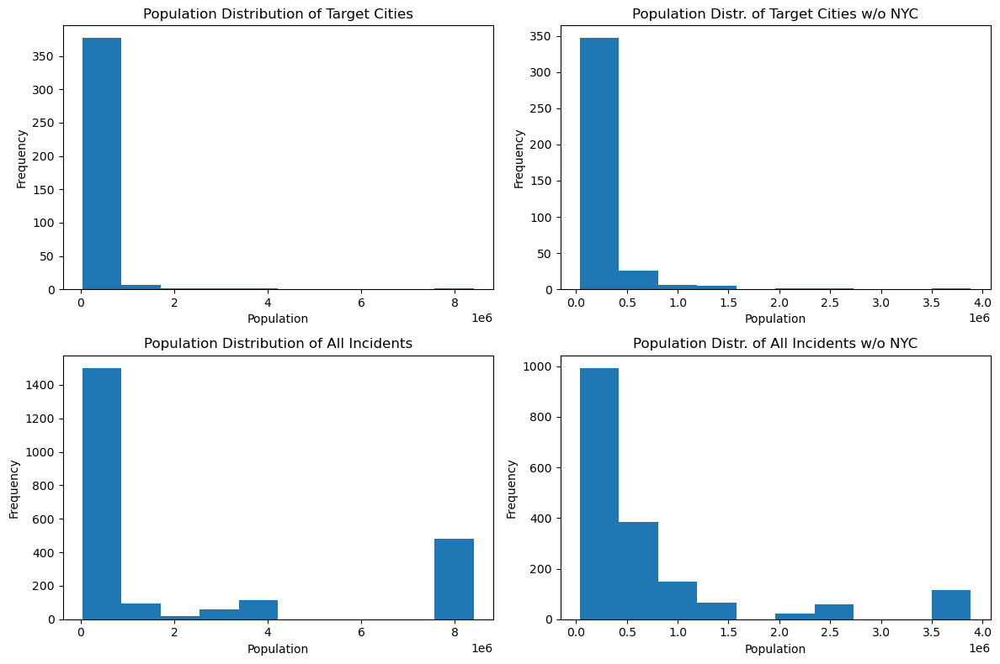

In [50]:
fig, ax = plt.subplots(2,2, figsize = (12,8))

pd.Series(dfp.population.unique()).plot(kind='hist', ax=ax[0,0])
ax[0,0].set_title('Population Distribution of Target Cities')
ax[0,0].set_xlabel('Population')
ax[0,0].set_ylabel('Frequency')

pd.Series(dfp[dfp['city'] != 'New York City'].population.unique()).plot(kind='hist', ax=ax[0,1])
ax[0,1].set_xlabel('Population')
ax[0,1].set_title('Population Distr. of Target Cities w/o NYC')

dfp.population.plot(kind='hist', ax=ax[1,0])
ax[1,0].set_title('Population Distribution of All Incidents')
ax[1,0].set_xlabel('Population')

dfp[dfp['city'] != 'New York City'].population.plot(kind='hist', ax=ax[1,1])
ax[1,1].set_title('Population Distr. of All Incidents w/o NYC')
ax[1,1].set_xlabel('Population')

plt.tight_layout()
plt.show();

In [51]:
vc = dfp['city'].value_counts()
city_of_int = vc[vc >= 10].index.tolist()
dfp10 = dfp[dfp['city'].isin(city_of_int)]

dfp10.groupby('city')['incidents_per_100k_city'].mean().head()

city
Albuquerque     2.695442
Arlington       3.688316
Atlanta         3.349403
Baton Rouge     4.794574
Berkeley       29.117566
Name: incidents_per_100k_city, dtype: float64

city
New York City    482
Los Angeles      114
San Francisco    102
Washington        93
Miami             88
Name: count, dtype: int64
city
Berkeley       29.117566
Miami          21.070274
Olympia        20.687658
Palo Alto      16.506107
Bloomington    14.427190
Name: incidents_per_100k_city, dtype: float64


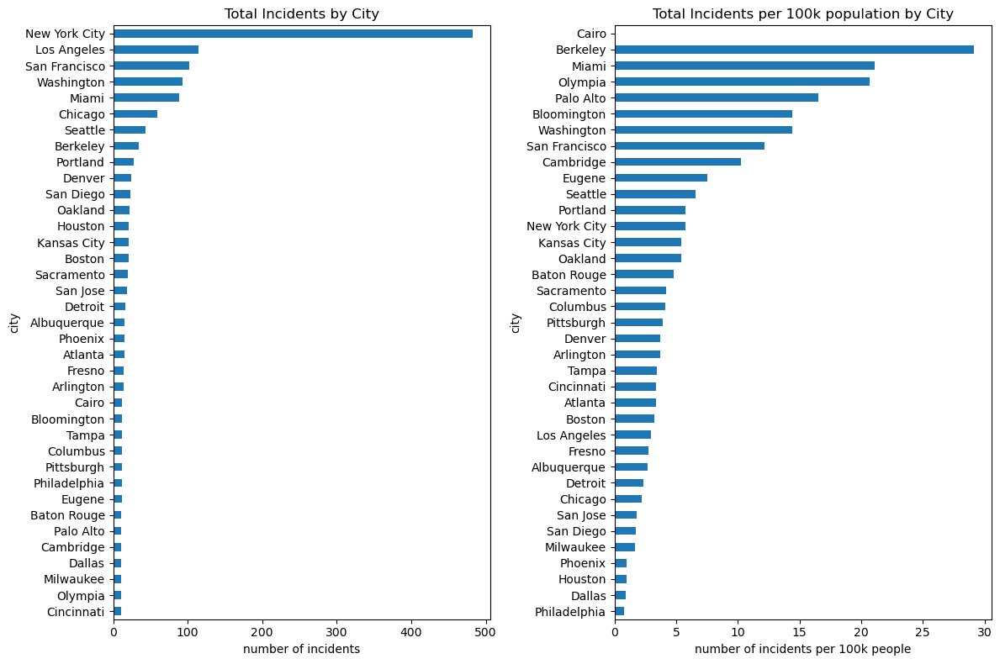

In [52]:
vc = dfp['city'].value_counts()
city_of_int = vc[vc >= 10].index.tolist()
dfp10 = dfp[dfp['city'].isin(city_of_int)]

print(dfp10.city.value_counts().head())
print(dfp10.groupby('city')['incidents_per_100k_city'].mean().sort_values(ascending=False).head())

dfp10.reset_index(drop=True, inplace=True)

fig, ax = plt.subplots(1,2, figsize=(12,8))
dfp10.city.value_counts().sort_values().plot(kind='barh', ax=ax[0])
pd.Series(dfp10.groupby('city')['incidents_per_100k_city'].mean()).sort_values().plot(kind='barh', ax=ax[1])
ax[0].set_title('Total Incidents by City')
ax[0].set_xlabel('number of incidents')
ax[1].set_xlabel('number of incidents per 100k people')
ax[1].set_title('Total Incidents per 100k population by City')
plt.tight_layout()
plt.show;

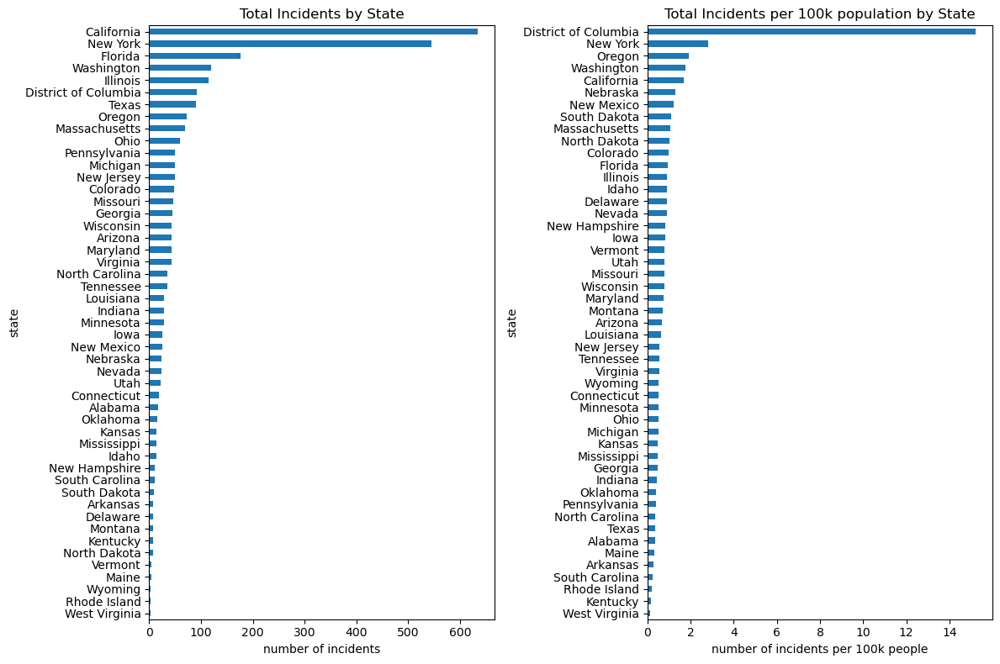

In [53]:
fig, ax = plt.subplots(1,2, figsize=(12,8))
dfcm.iloc[:,31].sort_values().plot(kind='barh',ax=ax[0])
dfcm.iloc[:,372].sort_values().plot(kind='barh', ax=ax[1])
ax[0].set_title('Total Incidents by State')
ax[0].set_xlabel('number of incidents')
ax[1].set_xlabel('number of incidents per 100k people')
ax[1].set_title('Total Incidents per 100k population by State')
plt.tight_layout()
plt.show;

In [54]:
feat_of_int = ['success','suicide','nkill','nwound','nkillter','attacktype1_txt','targtype1_txt','weaptype1_txt','propextent_txt']

### Now, how do certain features of interest interact with census data? Are there any correlations of interest? We'll focus on target type and attack type as the main features to analyze and ultimately forecast. First, I'll look at basic distributions and then evaluate the relationship to city and state population.

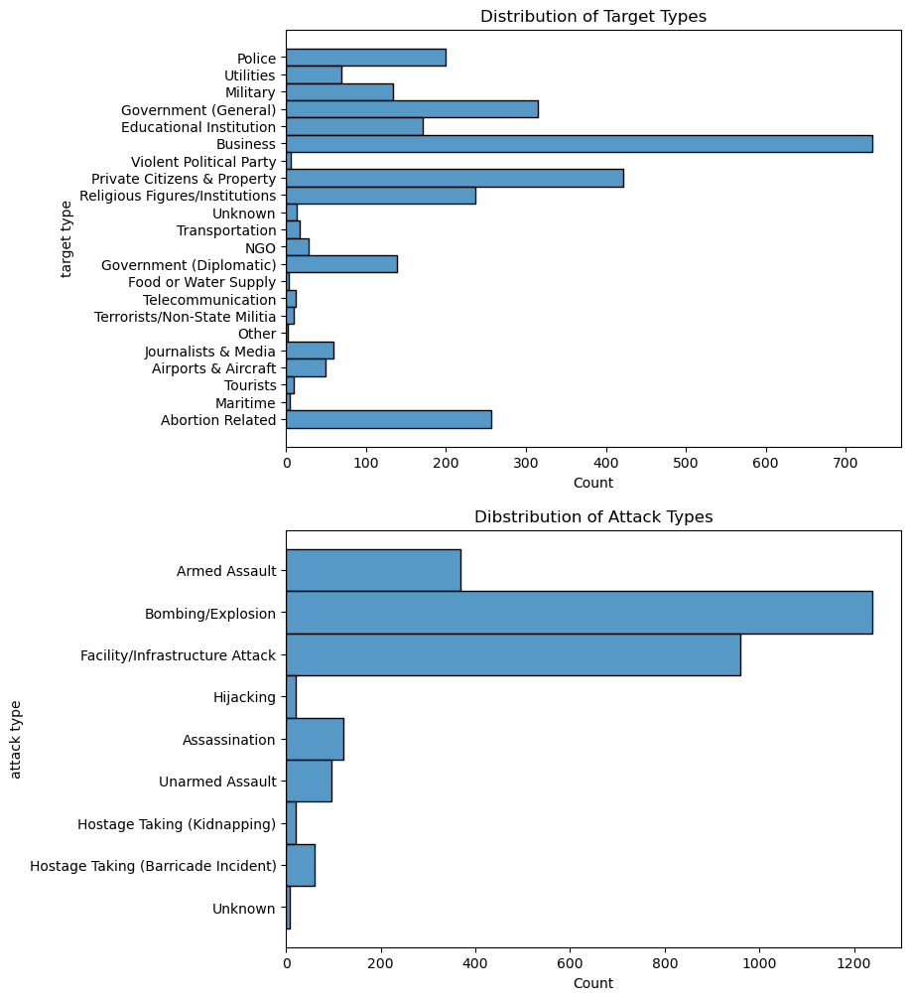

In [55]:
fig, ax = plt.subplots(2,1, figsize = (8,12))
sns.histplot(y=dfp.targtype1_txt, ax=ax[0])
ax[0].set_ylabel('target type')
ax[0].set_title('Distribution of Target Types')
sns.histplot(y=dfp.attacktype1_txt, ax=ax[1])
ax[1].set_ylabel('attack type')
ax[1].set_title('Dibstribution of Attack Types')
plt.show();

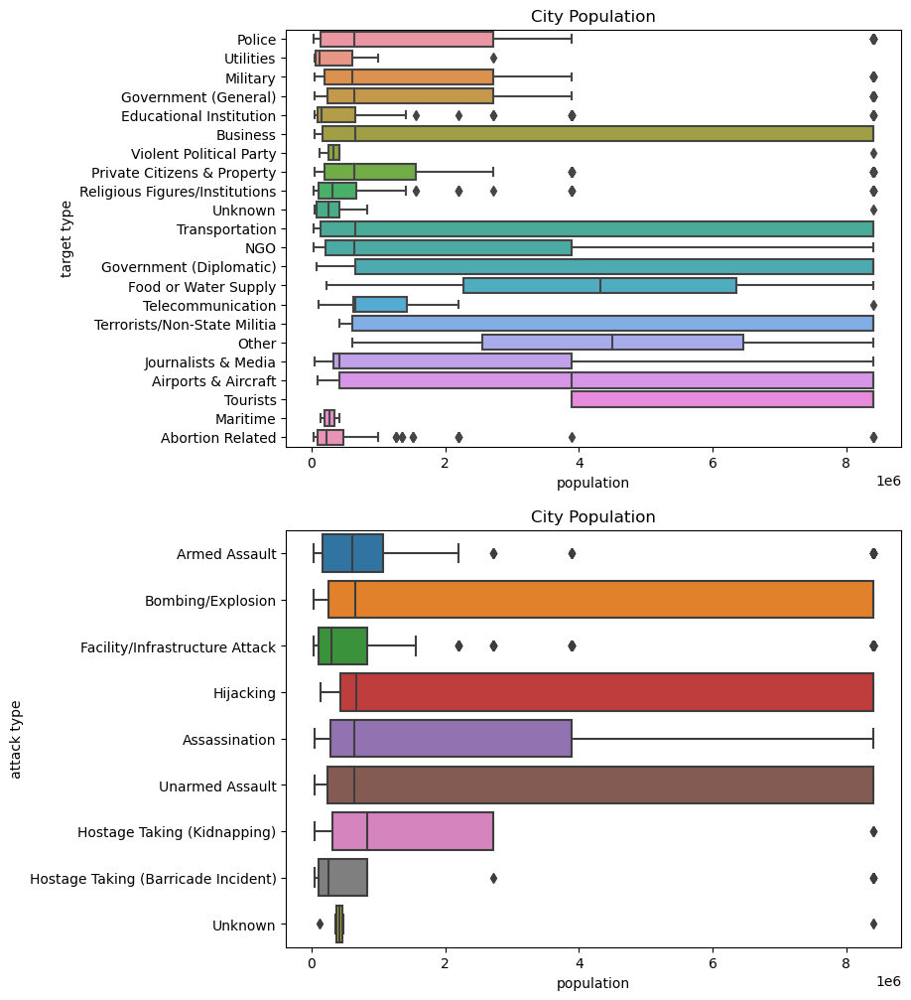

In [56]:
fig, ax = plt.subplots(2,1, figsize = (8,12))
sns.boxplot(y=dfp.targtype1_txt, x=dfp.population, ax=ax[0])
ax[0].set_ylabel('target type')
ax[0].set_title('City Population')
sns.boxplot(y=dfp.attacktype1_txt, x=dfp.population, ax=ax[1])
ax[1].set_ylabel('attack type')
ax[1].set_title('City Population')
plt.show();

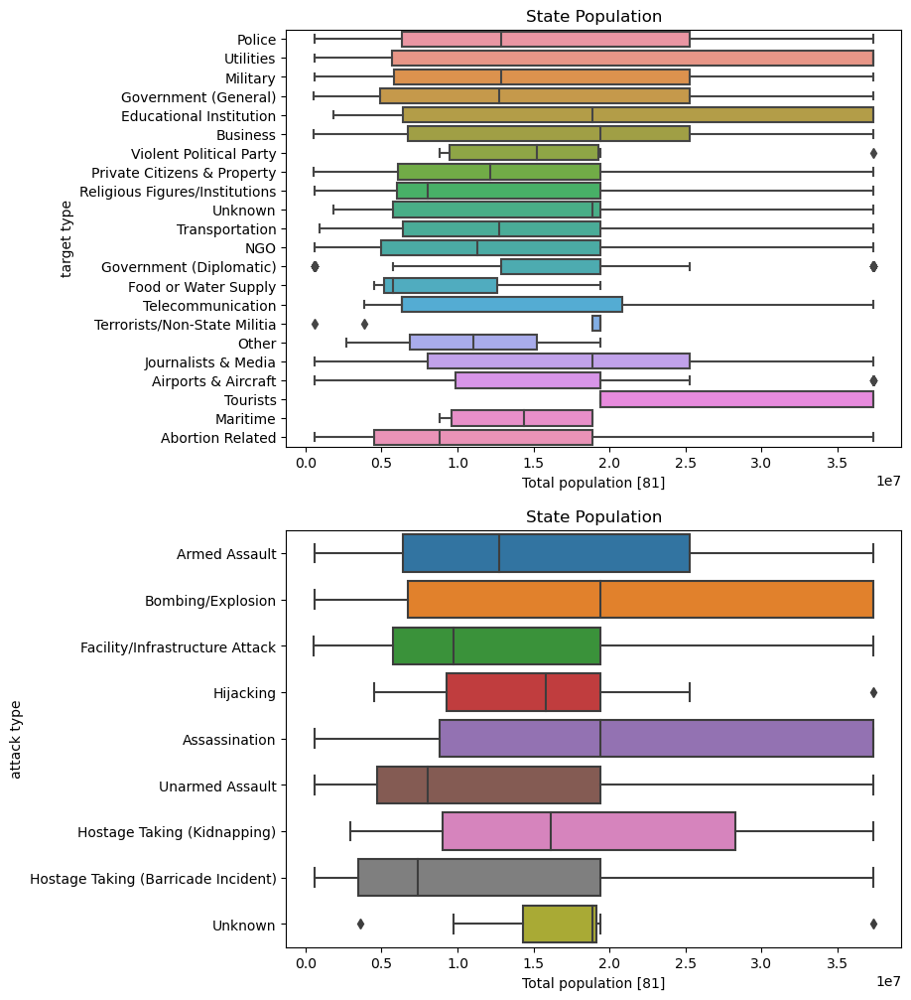

In [57]:
fig, ax = plt.subplots(2,1, figsize = (8,12))
sns.boxplot(y=dfbig.iloc[:,16], x=dfbig.iloc[:,81], ax=ax[0])
ax[0].set_ylabel('target type')
ax[0].set_title('State Population')
sns.boxplot(y=dfbig.iloc[:,15], x=dfbig.iloc[:,81], ax=ax[1])
ax[1].set_ylabel('attack type')
ax[1].set_title('State Population')
plt.show();

### Interesting patterns. For a more in depth analysis of relationships between incidents and census data, I'll define a function 'featureplot' to generate a scatterplot of every numeric value in the census data versus any chosen feature. I'll begin with total incidents per state and incidents per 100k people per state.

In [64]:
dfbig.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2889 entries, 0 to 2888
Columns: 421 entries, eventid [0] to incidents_per_100k_state [420]
dtypes: float64(75), int64(96), object(250)
memory usage: 9.3+ MB


In [80]:
def featureplot(df, colstart=80, feature_iloc=0):
    dfc = df.iloc[:, colstart:]
    num_values = len(dfc.columns)
    num_cols = min(num_values, 3)  
    num_rows = -(-num_values // num_cols)  
    
    fig, ax = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    ax = ax.flatten()  
   
    for i, col in enumerate(dfc.columns):
        if pd.api.types.is_numeric_dtype(dfc[col]):
            xval = df.iloc[:, feature_iloc]
            yval = dfc[col]
            sns.scatterplot(x=xval, y=yval, ax=ax[i])
            ax[i].set_title(col) 
            
            pearson_corr = df[xval.name].corr(df[yval.name])
            
            if abs(pearson_corr) >= 0.25:  
                ax[i].set_facecolor('lightgreen')  
                ax[i].spines['top'].set_linewidth(2)  
                ax[i].spines['right'].set_linewidth(2)
                ax[i].spines['bottom'].set_linewidth(2)
                ax[i].spines['left'].set_linewidth(2)
            
            ax[i].set_title(f'{col} (Pearson Corr: {pearson_corr:.2f})') 
        
    for j in range(num_values, num_rows * num_cols):
        fig.delaxes(ax[j])
    
    plt.tight_layout()
    plt.show()

In [81]:
featureplot(dfbig, feature_iloc=79)

In [238]:
def featurebox(df, colstart=80, feature_iloc=0, subset_size=2):
    dfc = df.iloc[:, colstart:]
    num_values = len(dfc.columns)
    num_cols = min(num_values, 1)  
    num_rows = -(-num_values // num_cols)  
    
    # Determine the number of subsets
    num_subsets = -(-num_values // subset_size)
    
    for subset_index in range(num_subsets):
        start_col = subset_index * subset_size
        end_col = min((subset_index + 1) * subset_size, num_values)
        
        # Slice the DataFrame to include only the desired subset of columns
        subset_df = dfc.iloc[:, start_col:end_col]
        
        fig, ax = plt.subplots(1, len(subset_df.columns), figsize=(15, 5))
        
        for i, col in enumerate(subset_df.columns):
            if pd.api.types.is_numeric_dtype(subset_df[col]):
                yval = df.iloc[:, feature_iloc]
                xval = subset_df[col]
                sns.boxplot(x=xval, y=yval, ax=ax[i])
                ax[i].set_title(col)  # Set title for each subplot
        
        plt.tight_layout()
        plt.show()

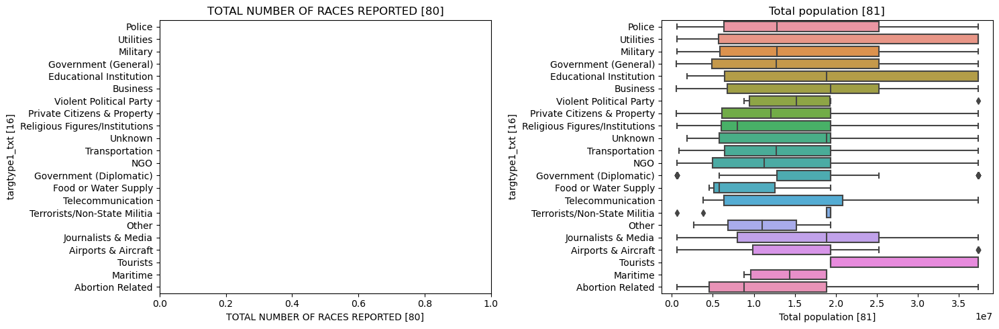

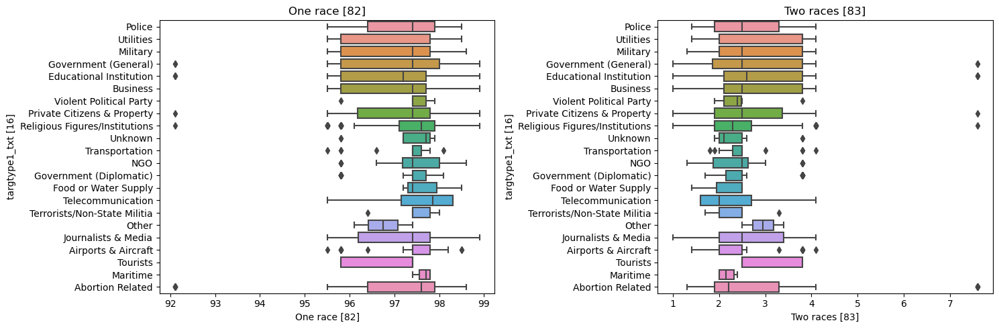

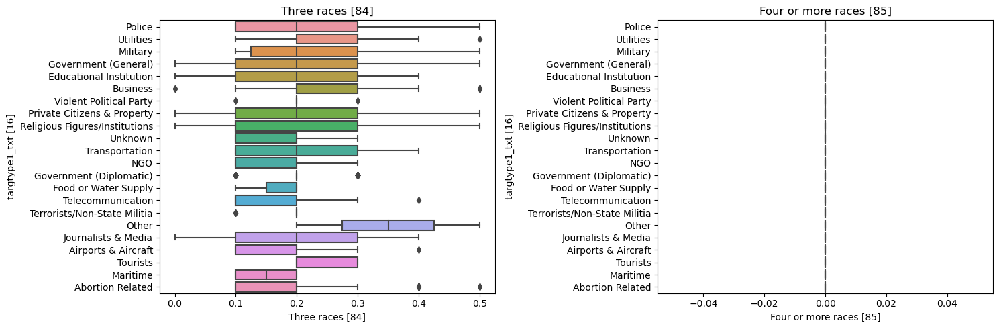

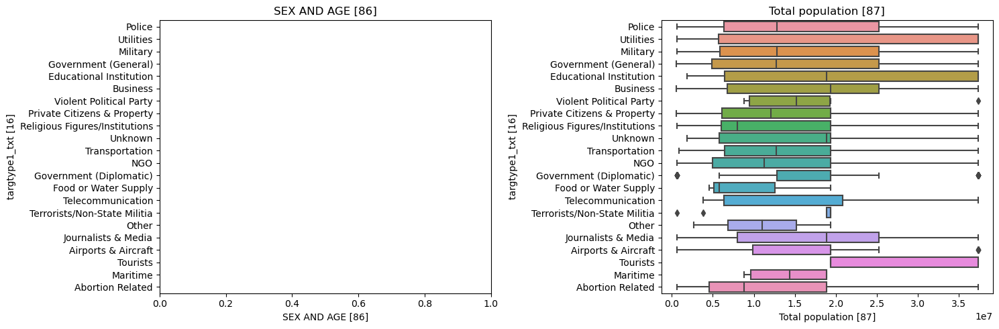

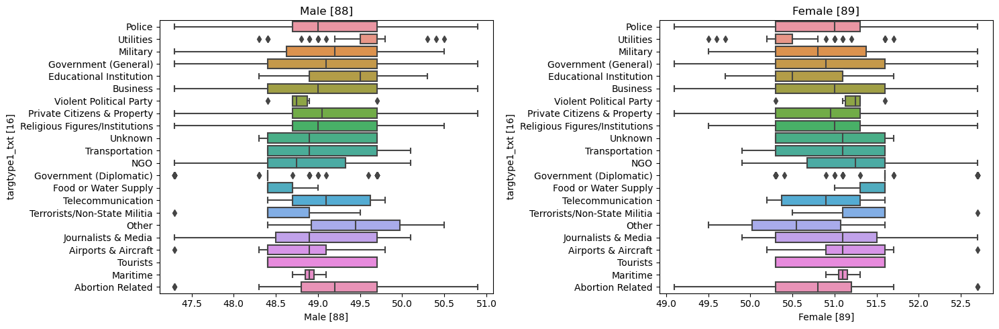

...

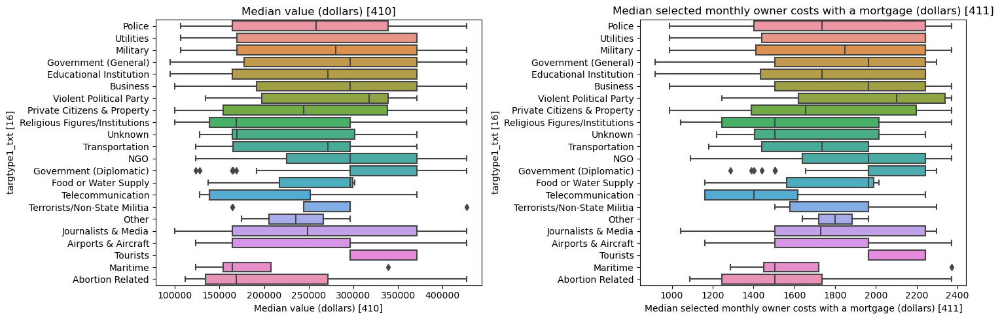

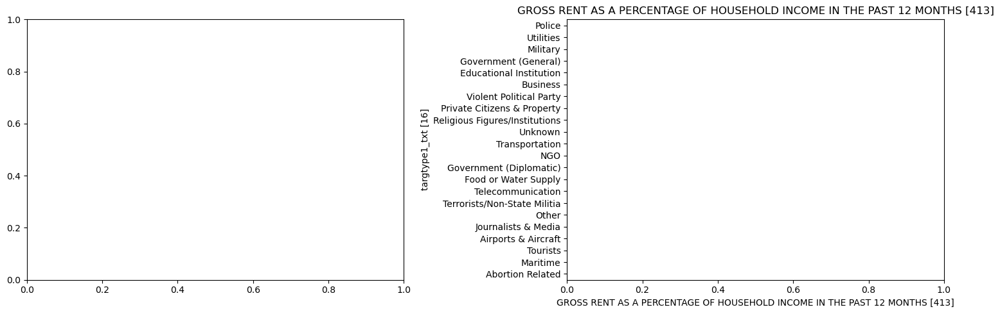

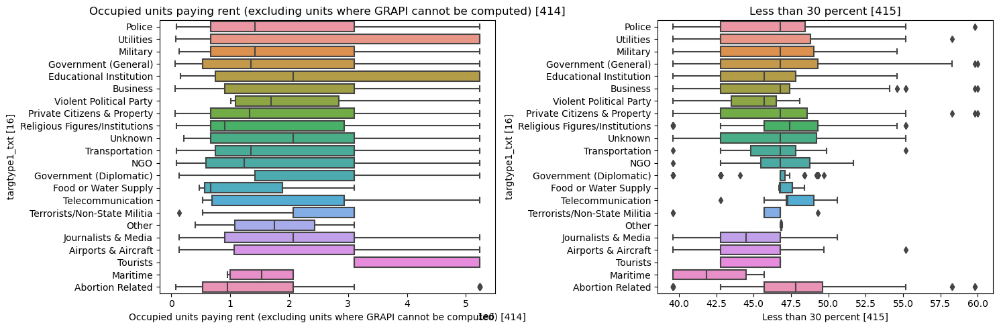

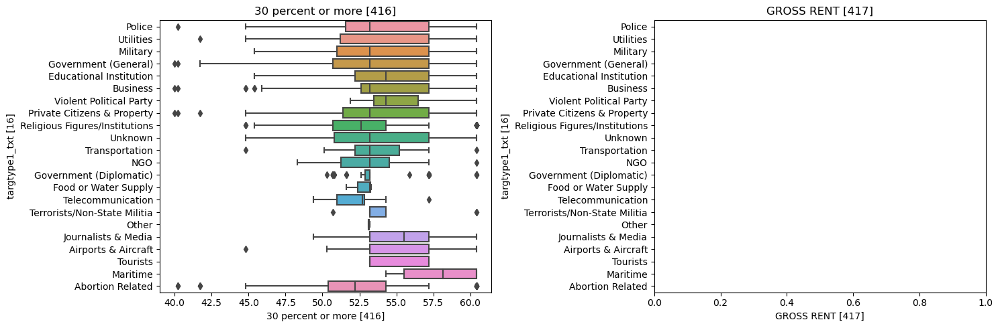

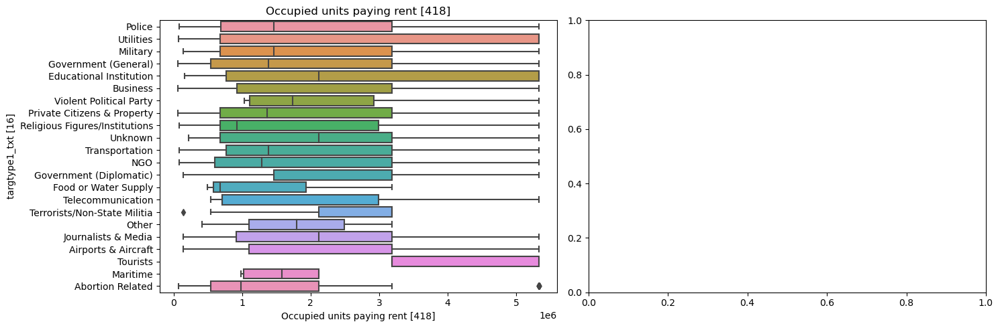

TypeError: 'Axes' object is not subscriptable

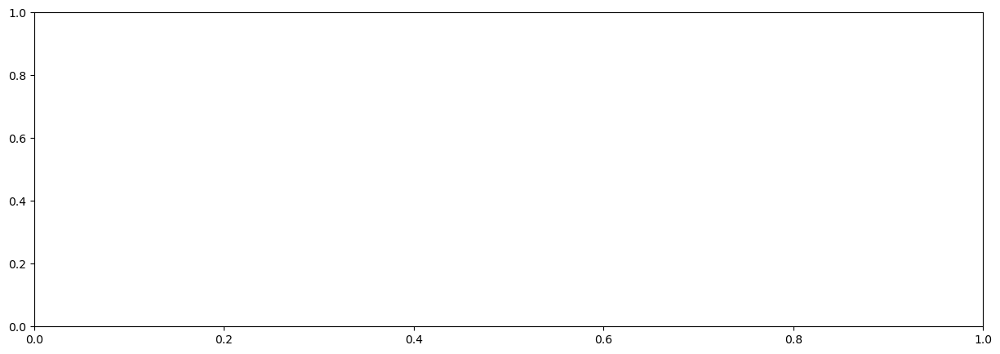

In [43]:
featurebox(dfbig, feature_iloc=16)

In [ ]:
featurebox(dfbig, feature_iloc=15)

In [87]:
heatmapdf = dfbig[[col for col in dfbig if dfbig[col].dtype != 'object']]
num_of_int = dfbig.iloc[:,24:26].join(dfbig.iloc[:,30:35]).join(dfbig.iloc[:,45:48]).join(dfbig.iloc[:,420])
subsets = [
    num_of_int.join(heatmapdf.loc[:, 'TOTAL NUMBER OF RACES REPORTED [80]':'Female [118]']),
    num_of_int.join(heatmapdf.loc[:, 'RELATIONSHIP [119]':'Not living alone [140]']),
    num_of_int.join(heatmapdf.loc[:, 'MARITAL STATUS [143]':'Never married [161]']),
    num_of_int.join(heatmapdf.loc[:, 'SCHOOL ENROLLMENT [162]':"Female, bachelor's degree or higher [187]"]),
    num_of_int.join(heatmapdf.loc[:, 'FERTILITY [188]':'With a disability [208]']),
    num_of_int.join(heatmapdf.loc[:, 'RESIDENCE 1 YEAR AGO [209]':'Entered before 1990 [234]']),
    num_of_int.join(heatmapdf.loc[:, 'WORLD REGION OF BIRTH OF FOREIGN BORN [235]':'Percent of civilian labor force [262]']),
    num_of_int.join(heatmapdf.loc[:, 'COMMUTING TO WORK [263]':'Production, transportation, and material moving occupations [290]']),
    num_of_int.join(heatmapdf.loc[:, 'INDUSTRY [291]':'Unpaid family workers [311]']),
    num_of_int.join(heatmapdf.loc[:, 'INCOME IN THE PAST 12 MONTHS (IN 2010 INFLATION-ADJUSTED DOLLARS) [312]':'Female [344]']),
    num_of_int.join(heatmapdf.loc[:, 'HEALTH INSURANCE COVERAGE [345]':'Unrelated individuals 15 years and over [369]']),
   num_of_int.join(heatmapdf.loc[:, 'HOUSING TENURE [370]':'Built 1939 or earlier [389]']),
    num_of_int.join(heatmapdf.loc[:, 'VEHICLES AVAILABLE [390]':'Occupied units paying rent [418]'])
]

fig, ax = plt.subplots(len(subsets), 1, figsize=(35, 25 * len(subsets)))

for i, sub_df in enumerate(subsets):
    mask = np.abs(sub_df.corr()) <= 0.4
    sns.heatmap(sub_df.corr(), annot = True, mask = mask, ax=ax[i])
    ax[i].set_title(f'Subplot {i+1}')
plt.tight_layout()
plt.show();
#print([col for col in dfbig if dfbig[col].dtype != 'object'])

In [192]:
feature_crossed = dfbig['attacktype1_txt [15]'] + '_' + dfbig['targtype1_txt [16]']

feature_crossed_df = pd.DataFrame(feature_crossed, columns=['feature_crossed'])
encoder = OneHotEncoder()
encoded_features = encoder.fit_transform(feature_crossed_df[['feature_crossed']])

encoded_features_df = pd.DataFrame(encoded_features.toarray(), columns=encoder.get_feature_names_out(['feature_crossed']))

dfbig_dropped = dfbig.drop(columns=['attacktype1_txt [15]', 'targtype1_txt [16]'])

encoded_other = pd.get_dummies(dfbig_dropped, columns=['success [13]', 'suicide [14]', 'guncertain1 [23]', 'INT_LOG [40]', 'INT_IDEO [41]', 'INT_MISC [42]', 'INT_ANY [43]'])

othercol_df = encoded_other.drop(encoded_other.columns[0:421], axis=1)

drop2 = dfbig_dropped.drop(columns=['success [13]', 'suicide [14]', 'guncertain1 [23]', 'INT_LOG [40]', 'INT_IDEO [41]', 'INT_MISC [42]', 'INT_ANY [43]'])

numdf = drop2[[col for col in drop2 if drop2[col].dtype != 'object' and not drop2[col].isna().any()]].iloc[:,11:]

df_analyze = numdf.drop(numdf.loc[:,'Abortion Related [48]':'Unknown_y [78]'],axis=1)

df_encoded = pd.concat([df_analyze, othercol_df, encoded_features_df], axis=1).copy() 

df_encoded.head()


,nkill [30],nkillus [31],nkillter [32],nwound [33],nwoundus [34],nwoundte [35],total_city_incidents [46],total_incidents_state [79],Total population [81],One race [82],Two races [83],Three races [84],Four or more races [85],Total population [87],Male [88],Female [89],Under 5 years [90],5 to 17 years [91],18 to 24 years [92],25 to 34 years [93],35 to 44 years [94],45 to 54 years [95],55 to 64 years [96],65 to 74 years [97],75 years and over [98],18 years and over [100],21 years and over [101],62 years and over [102],65 years and over [103],Under 18 years [104],Male [105],Female [106],18 years and over [107],Male [108],Female [109],18 to 34 years [110],Male [111],Female [112],35 to 64 years [113],Male [114],Female [115],65 years and over [116],Male [117],Female [118],Population in households [120],Householder or spouse [121],Child [122],Other relatives [123],Nonrelatives [124],Unmarried partner [125],Households [127],Family households [128],With own children under 18 years [129],Married-couple family [130],With own children under 18 years [131],"Female householder, no husband present, family [132]",With own children under 18 years [133],Nonfamily households [134],Male householder [135],Living alone [136],Not living alone [137],Female householder [138],Living alone [139],Not living alone [140],Population 15 years and over [144],"Now married, except separated [145]",Widowed [146],Divorced [147],Separated [148],Never married [149],Male 15 years and over [150],"Now married, except separated [151]",Widowed [152],Divorced [153],Separated [154],Never married [155],Female 15 years and over [156],"Now married, except separated [157]",Widowed [158],Divorced [159],Separated [160],Never married [161],Population 3 years and over enrolled in school [163],"Nursery school, preschool [164]",Kindergarten [165],Elementary school (grades 1-8) [166],High school (grades 9-12) [167],College or graduate school [168],Male 3 years and over enrolled in school [169],Percent enrolled in kindergarten to grade 12 [170],Percent enrolled in college or graduate school [171],Female 3 years and over enrolled in school [172],Percent enrolled in kindergarten to grade 12 [173],Percent enrolled in college or graduate school [174],Population 25 years and over [176],Less than high school diploma [177],High school graduate (includes equivalency) [178],Some college or associate's degree [179],Bachelor's degree [180],Graduate or professional degree [181],High school graduate or higher [182],"Male, high school graduate or higher [183]","Female, high school graduate or higher [184]",Bachelor's degree or higher [185],"Male, bachelor's degree or higher [186]","Female, bachelor's degree or higher [187]",Women 15 to 50 years [189],Women 15 to 50 years who had a birth in the past 12 months [190],Unmarried women 15 to 50 years who had a birth in the past 12 months [191],As a percent of all women with a birth in the past 12 months [192],Population 30 years and over [194],Living with grandchild(ren) [195],Responsible for grandchild(ren) [196],Civilian population 18 years and over [198],Civilian veteran [199],Total civilian noninstitutionalized population [201],With a disability [202],Civilian noninstitutionalized population under 18 years [203],With a disability [204],Civilian noninstitutionalized population 18 to 64 years [205],With a disability [206],Civilian noninstitutionalized population 65 years and older [207],With a disability [208],Population 1 year and over [210],Same house [211],Different house in the U.S. [212],Same county [213],Different county [214],Same state [215],Different state [216],Abroad [217],Native [219],Male [220],Female [221],Foreign born [222],Male [223],Female [224],Foreign born; naturalized U.S. citizen [225],Male [226],Female [227],Foreign born; not a U.S. citizen [228],Male [229],Female [230],Population born outside the United States [231],Entered 2000 or later [232],Entered 1990 to 1999 [233],Entered before 1990 [234],Foreign-born population excluding 

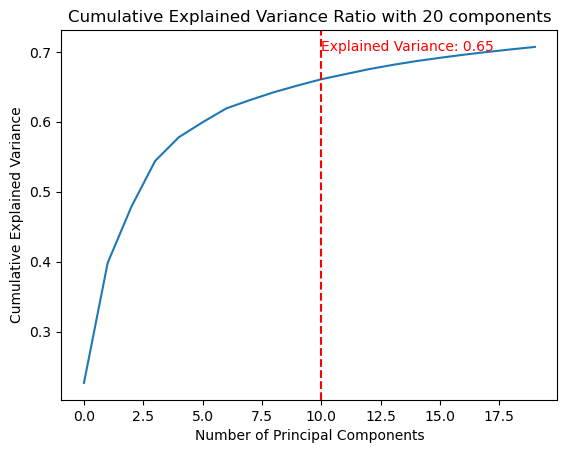

In [193]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df_encoded)
n_comp = 20
pca = PCA(n_components = n_comp)
principal_components = pca.fit_transform(scaled_features)

plt.plot(pca.explained_variance_ratio_.cumsum())
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title(f'Cumulative Explained Variance Ratio with {n_comp} components')
plt.axvline(x=10, color='red', linestyle='--')  
plt.text(10, pca.explained_variance_ratio_[:10].cumsum()[-1] + 0.05, f'Explained Variance: {pca.explained_variance_ratio_[:10].cumsum()[-1]:.2f}', color='red')  # Annotate the y value at x = 6
plt.show();

C:\Users\casti\anaconda3\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


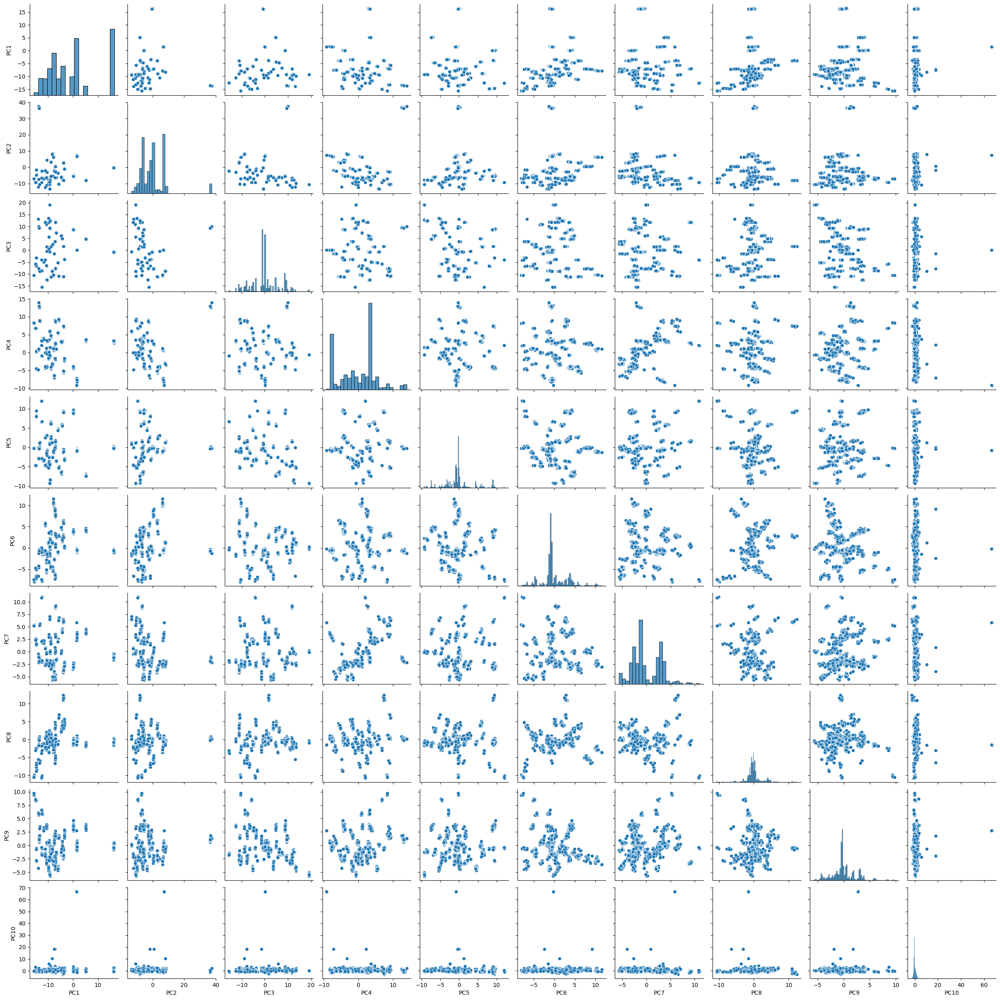

In [194]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df_encoded)
n_comp = 10
pca = PCA(n_components = n_comp)
principal_components = pca.fit_transform(scaled_features)

transformed_df = pd.DataFrame(data=principal_components, columns=[f'PC{i+1}' for i in range(10)])

sns.pairplot(transformed_df)

plt.show();

In [223]:
loadings = pca.components_

# Create a DataFrame to store the loadings
loadings_df = pd.DataFrame(loadings, columns=df_encoded.columns)

top_features = {}
for i, component in enumerate(loadings):
    top_features[f'PC{i+1}'] = loadings_df.abs().iloc[i].nlargest(10).index.tolist()

# Display the top features for each principal component
for pc, features in top_features.items():
    print('*' * 50)
    print(f'Principal Component {pc}: {features}')

**************************************************
Principal Component PC1: ['Total population [81]', 'Total population [87]', 'Individuals [334]', 'Population 1 year and over [210]', 'Total civilian noninstitutionalized population [201]', 'Civilian noninstitutionalized population [346]', 'Population in households [120]', 'Population 5 years and over [244]', 'Population 15 years and over [144]', 'Population 16 years and over [249]']
**************************************************
Principal Component PC2: ['Foreign born [222]', 'Population born outside the United States [231]', 'Foreign-born population excluding population born at sea [236]', 'Native [219]', 'Foreign born; not a U.S. citizen [228]', 'Foreign born; naturalized U.S. citizen [225]', 'Owner-occupied housing units [409]', 'Households [127]', 'Households [313]', 'Occupied housing units [371]']
**************************************************
Principal Component PC3: ['Civilian noninstitutionalized population under 18 yea

In [224]:
bottom_features = {}
for i, component in enumerate(loadings):
    bottom_features[f'PC{i+1}'] = loadings_df.abs().iloc[i].nsmallest(10).index.tolist()

# Display the top features for each principal component
for pc, features in bottom_features.items():
    print('*' * 50)
    print(f'Principal Component {pc}: {features}')

**************************************************
Principal Component PC1: ['Four or more races [85]', 'feature_crossed_Assassination_Educational Institution', 'feature_crossed_Hostage Taking (Barricade Incident)_Government (Diplomatic)', 'feature_crossed_Armed Assault_Maritime', 'feature_crossed_Unknown_Government (Diplomatic)', 'feature_crossed_Facility/Infrastructure Attack_Terrorists/Non-State Militia', 'feature_crossed_Hijacking_Business', 'feature_crossed_Facility/Infrastructure Attack_Unknown', 'feature_crossed_Unknown_Government (General)', 'feature_crossed_Hostage Taking (Kidnapping)_Business']
**************************************************
Principal Component PC2: ['Four or more races [85]', 'feature_crossed_Assassination_Government (General)', 'feature_crossed_Unarmed Assault_Airports & Aircraft', 'feature_crossed_Hostage Taking (Barricade Incident)_Military', 'feature_crossed_Hijacking_Government (General)', 'feature_crossed_Facility/Infrastructure Attack_Telecommunica

In [206]:
pca = PCA(n_components=10)
pca.fit(df_encoded)

cumulative_variance = np.cumsum(pca.explained_variance_ratio_)

# Determine the number of principal components needed to reach the threshold
num_components_threshold = np.argmax(cumulative_variance >= 0.10) + 1

# Identify features with low loadings for principal components beyond the threshold
low_loadings_threshold = 0.8  # Define your low loadings threshold
low_loading_features = []
for i in range(num_components_threshold, n_components):
    low_loading_features.extend(loadings_df[loadings_df[f'PC{i+1}'].abs() < low_loadings_threshold].index)

# Filter out features with low loadings
filtered_features = [col for col in df_encoded.columns if col not in low_loading_features]

# Create a new DataFrame with filtered features
df_filtered = df_encoded[filtered_features]
df_filtered

,nkill [30],nkillus [31],nkillter [32],nwound [33],nwoundus [34],nwoundte [35],total_city_incidents [46],total_incidents_state [79],Total population [81],One race [82],Two races [83],Three races [84],Four or more races [85],Total population [87],Male [88],Female [89],Under 5 years [90],5 to 17 years [91],18 to 24 years [92],25 to 34 years [93],35 to 44 years [94],45 to 54 years [95],55 to 64 years [96],65 to 74 years [97],75 years and over [98],18 years and over [100],21 years and over [101],62 years and over [102],65 years and over [103],Under 18 years [104],Male [105],Female [106],18 years and over [107],Male [108],Female [109],18 to 34 years [110],Male [111],Female [112],35 to 64 years [113],Male [114],Female [115],65 years and over [116],Male [117],Female [118],Population in households [120],Householder or spouse [121],Child [122],Other relatives [123],Nonrelatives [124],Unmarried partner [125],Households [127],Family households [128],With own children under 18 years [129],Married-couple family [130],With own children under 18 years [131],"Female householder, no husband present, family [132]",With own children under 18 years [133],Nonfamily households [134],Male householder [135],Living alone [136],Not living alone [137],Female householder [138],Living alone [139],Not living alone [140],Population 15 years and over [144],"Now married, except separated [145]",Widowed [146],Divorced [147],Separated [148],Never married [149],Male 15 years and over [150],"Now married, except separated [151]",Widowed [152],Divorced [153],Separated [154],Never married [155],Female 15 years and over [156],"Now married, except separated [157]",Widowed [158],Divorced [159],Separated [160],Never married [161],Population 3 years and over enrolled in school [163],"Nursery school, preschool [164]",Kindergarten [165],Elementary school (grades 1-8) [166],High school (grades 9-12) [167],College or graduate school [168],Male 3 years and over enrolled in school [169],Percent enrolled in kindergarten to grade 12 [170],Percent enrolled in college or graduate school [171],Female 3 years and over enrolled in school [172],Percent enrolled in kindergarten to grade 12 [173],Percent enrolled in college or graduate school [174],Population 25 years and over [176],Less than high school diploma [177],High school graduate (includes equivalency) [178],Some college or associate's degree [179],Bachelor's degree [180],Graduate or professional degree [181],High school graduate or higher [182],"Male, high school graduate or higher [183]","Female, high school graduate or higher [184]",Bachelor's degree or higher [185],"Male, bachelor's degree or higher [186]","Female, bachelor's degree or higher [187]",Women 15 to 50 years [189],Women 15 to 50 years who had a birth in the past 12 months [190],Unmarried women 15 to 50 years who had a birth in the past 12 months [191],As a percent of all women with a birth in the past 12 months [192],Population 30 years and over [194],Living with grandchild(ren) [195],Responsible for grandchild(ren) [196],Civilian population 18 years and over [198],Civilian veteran [199],Total civilian noninstitutionalized population [201],With a disability [202],Civilian noninstitutionalized population under 18 years [203],With a disability [204],Civilian noninstitutionalized population 18 to 64 years [205],With a disability [206],Civilian noninstitutionalized population 65 years and older [207],With a disability [208],Population 1 year and over [210],Same house [211],Different house in the U.S. [212],Same county [213],Different county [214],Same state [215],Different state [216],Abroad [217],Native [219],Male [220],Female [221],Foreign born [222],Male [223],Female [224],Foreign born; naturalized U.S. citizen [225],Male [226],Female [227],Foreign born; not a U.S. citizen [228],Male [229],Female [230],Population born outside the United States [231],Entered 2000 or later [232],Entered 1990 to 1999 [233],Entered before 1990 [234],Foreign-born population excluding 

In [232]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df_encoded)
n_comp = 20
pca = PCA(n_components = n_comp)
principal_components = pca.fit_transform(scaled_features)
loadings = pca.components_
loadings_df = pd.DataFrame(loadings, columns=df_encoded.columns)

top_features = {}
for i, component in enumerate(loadings):
    top_features[f'PC{i+1}'] = loadings_df.abs().iloc[i].nlargest(5).index.tolist()
    
ft_keep = []
for k,v in top_features.items():
    ft_keep.extend(v)
df_keep = df_encoded[ft_keep]
df_keep.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2889 entries, 0 to 2888
Data columns (total 100 columns):
 #   Column                                                                          Non-Null Count  Dtype  
---  ------                                                                          --------------  -----  
 0   18 to 34 years [110]                                                            2889 non-null   int64  
 1   Foreign born; not a U.S. citizen [228]                                          2889 non-null   int64  
 2   Male 3 years and over enrolled in school [169]                                  2889 non-null   int64  
 3   Population 3 years and over enrolled in school [163]                            2889 non-null   int64  
 4   Women 15 to 50 years [189]                                                      2889 non-null   int64  
 5   Graduate or professional degree [181]                                           2889 non-null   float64
 6   Never married [

In [253]:
df_keep_t = df_keep.T[~df_keep.T.duplicated()]
df_uniq = df_keep_t.T
df_uniq.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2889 entries, 0 to 2888
Data columns (total 74 columns):
 #   Column                                                                          Non-Null Count  Dtype 
---  ------                                                                          --------------  ----- 
 0   18 to 34 years [110]                                                            2889 non-null   object
 1   Foreign born; not a U.S. citizen [228]                                          2889 non-null   object
 2   Male 3 years and over enrolled in school [169]                                  2889 non-null   object
 3   Population 3 years and over enrolled in school [163]                            2889 non-null   object
 4   Women 15 to 50 years [189]                                                      2889 non-null   object
 5   Graduate or professional degree [181]                                           2889 non-null   object
 6   Never married [161]     

In [257]:
df_uniq.drop(columns=['Male 3 years and over enrolled in school [169]','Women 15 to 50 years [189]','Never married [161]','Never married [155]','With related children under 18 years [352]','Related children under 5 years [363]','18 to 64 years [366]','Widowed [158]','62 years and over [102]','Male [223]','Female [224]','Unemployed [261]','Male [105]','Female [106]','Male [229]'], inplace=True)
df_uniq = df_uniq.infer_objects()
df_uniq.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2889 entries, 0 to 2888
Data columns (total 59 columns):
 #   Column                                                                          Non-Null Count  Dtype  
---  ------                                                                          --------------  -----  
 0   18 to 34 years [110]                                                            2889 non-null   int64  
 1   Foreign born; not a U.S. citizen [228]                                          2889 non-null   int64  
 2   Population 3 years and over enrolled in school [163]                            2889 non-null   int64  
 3   Graduate or professional degree [181]                                           2889 non-null   float64
 4   Never married [149]                                                             2889 non-null   float64
 5   Management, business, science, and arts occupations [286]                       2889 non-null   float64
 6   Related children

In [261]:
df_final = pd.concat([df_uniq.drop(columns = [x for x in df_uniq.columns if df_uniq[x].dtype == 'bool']), dfbig[['attacktype1_txt [15]','targtype1_txt [16]']]], axis=1)
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2889 entries, 0 to 2888
Data columns (total 52 columns):
 #   Column                                                                          Non-Null Count  Dtype  
---  ------                                                                          --------------  -----  
 0   18 to 34 years [110]                                                            2889 non-null   int64  
 1   Foreign born; not a U.S. citizen [228]                                          2889 non-null   int64  
 2   Population 3 years and over enrolled in school [163]                            2889 non-null   int64  
 3   Graduate or professional degree [181]                                           2889 non-null   float64
 4   Never married [149]                                                             2889 non-null   float64
 5   Management, business, science, and arts occupations [286]                       2889 non-null   float64
 6   Related children

In [267]:
def featurebox2(df, feature_iloc=0, subset_size=2):
    #dfc = df.iloc[:, colstart:]
    num_values = len(df.columns)
    num_cols = min(num_values, 1)  
    num_rows = -(-num_values // num_cols)  
    
    # Determine the number of subsets
    num_subsets = -(-num_values // subset_size)
    
    for subset_index in range(num_subsets):
        start_col = subset_index * subset_size
        end_col = min((subset_index + 1) * subset_size, num_values)
        
        # Slice the DataFrame to include only the desired subset of columns
        subset_df = df.iloc[:, start_col:end_col]
        
        fig, ax = plt.subplots(1, len(subset_df.columns), figsize=(15, 5))
        
        for i, col in enumerate(subset_df.columns):
            if pd.api.types.is_numeric_dtype(subset_df[col]):
                yval = df.iloc[:, feature_iloc]
                xval = subset_df[col]
                sns.boxplot(x=xval, y=yval, ax=ax[i])
                ax[i].set_title(col)  # Set title for each subplot
                
        for j in range(num_values, num_rows * num_cols):
        fig.delaxes(ax[j])
        
        plt.tight_layout()
        plt.show();

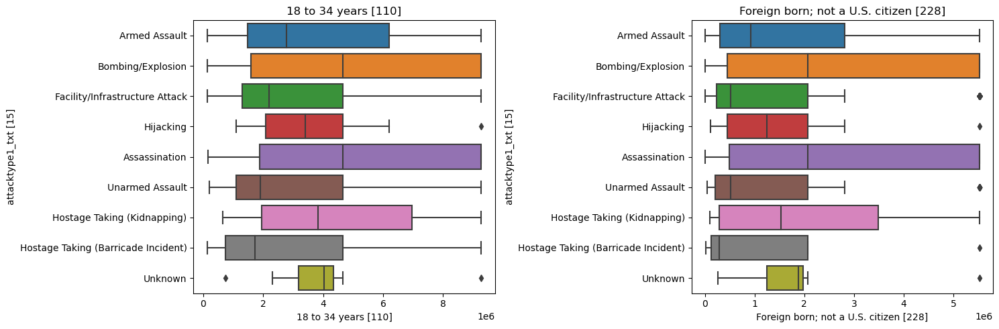

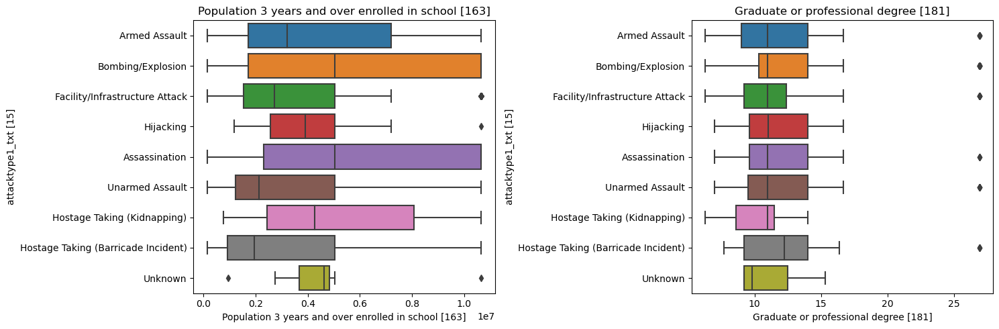

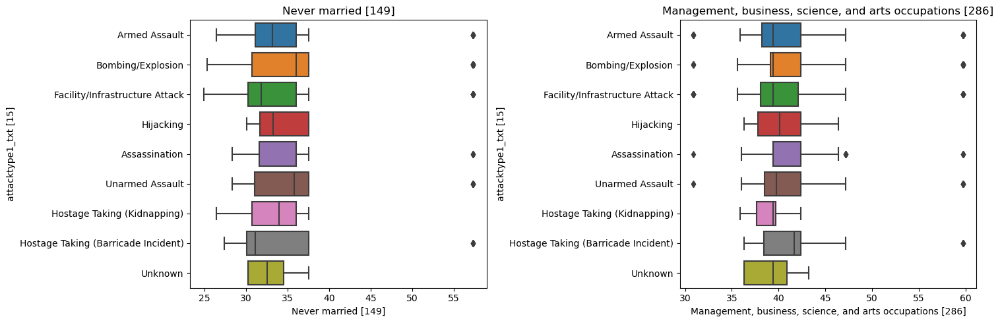

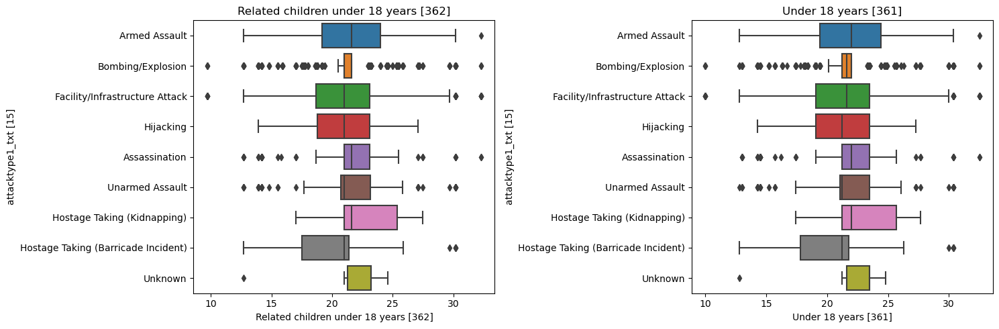

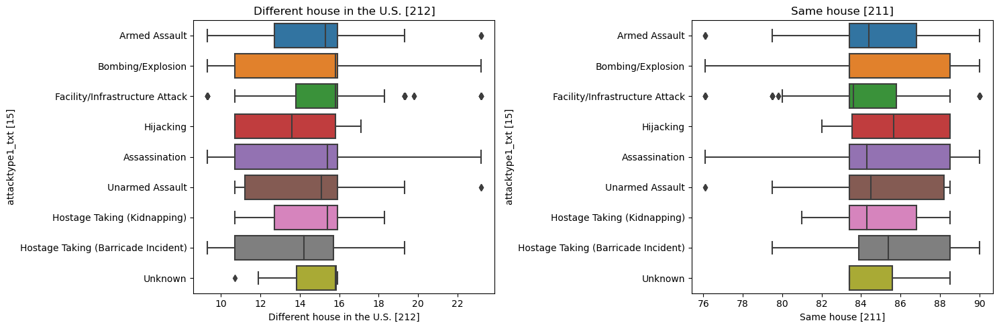

...

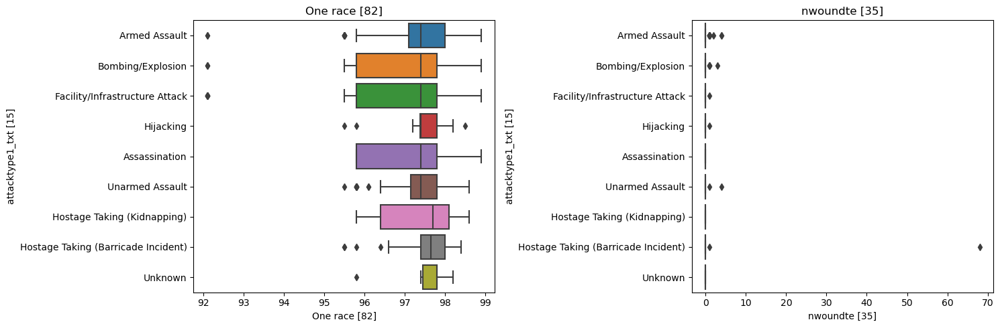

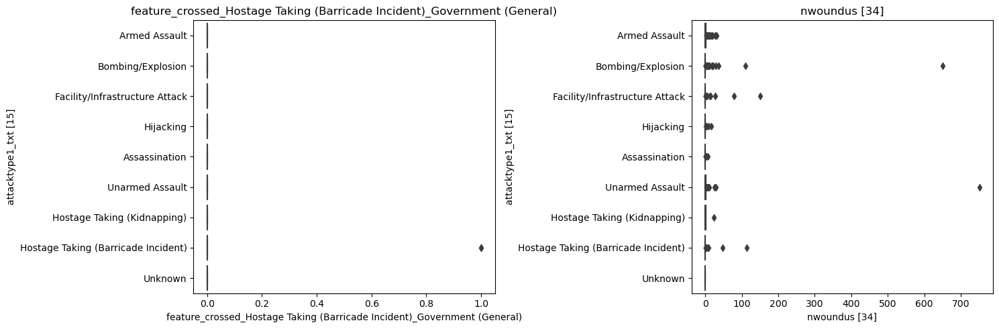

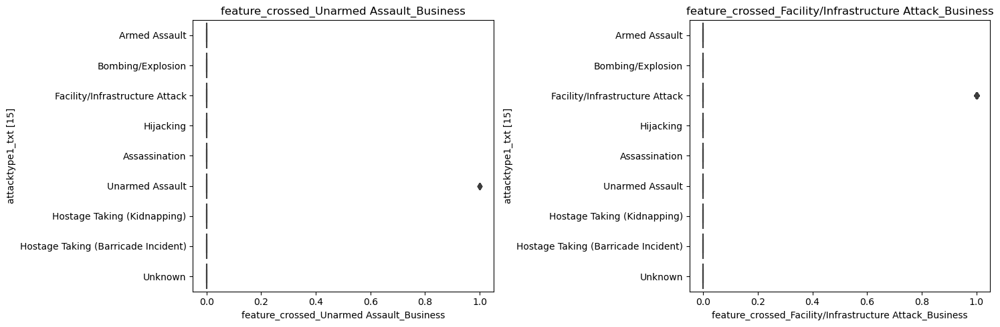

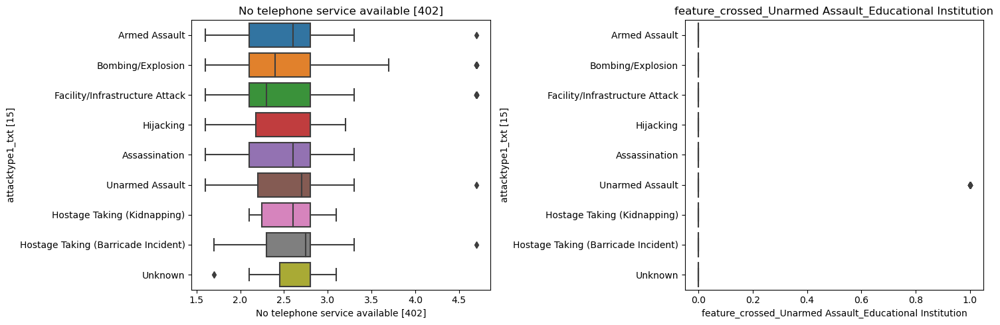

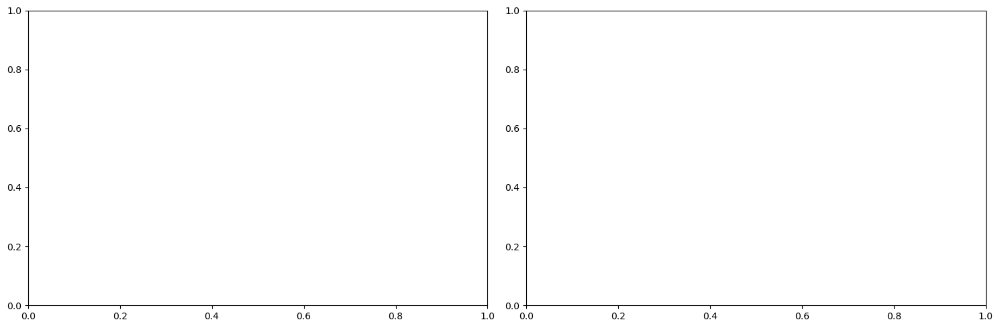

In [271]:
featurebox2(df_final, feature_iloc=50)

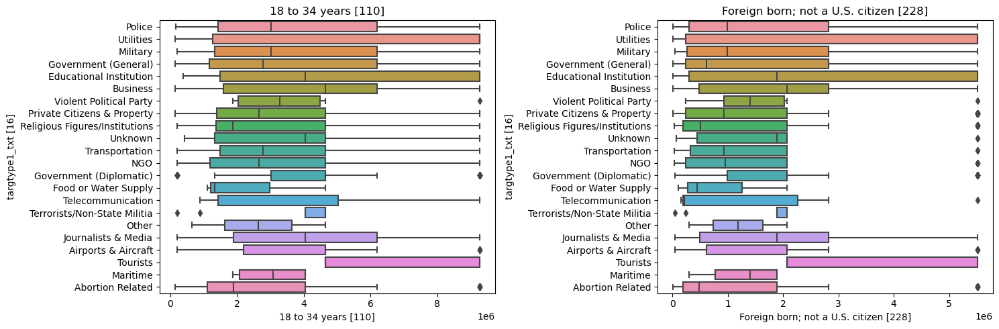

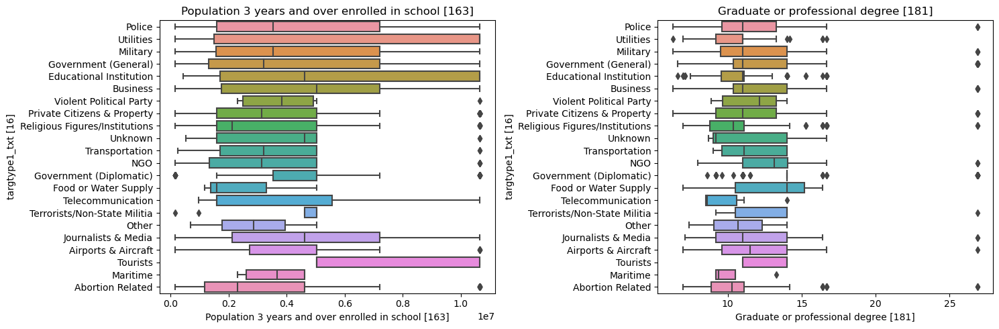

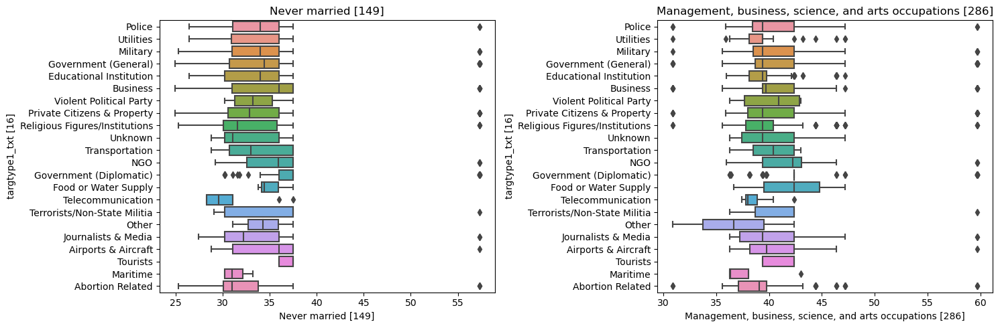

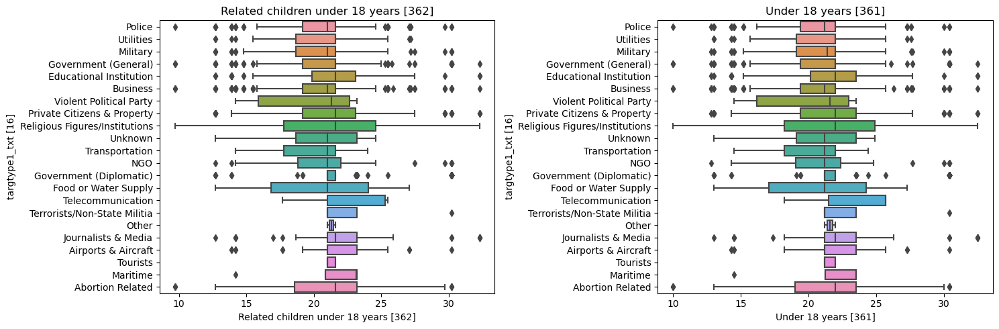

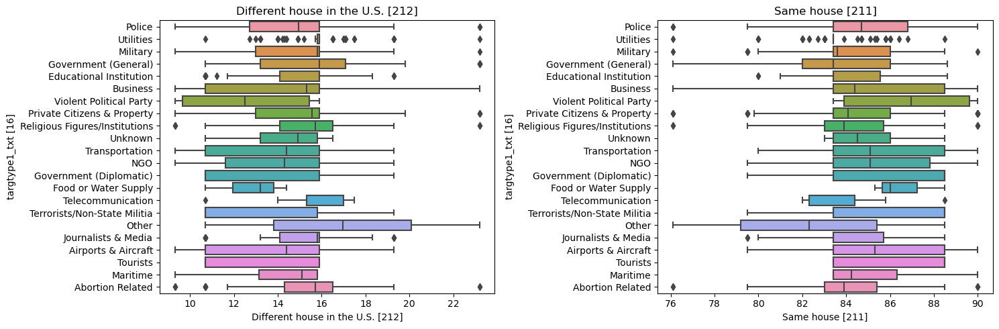

...

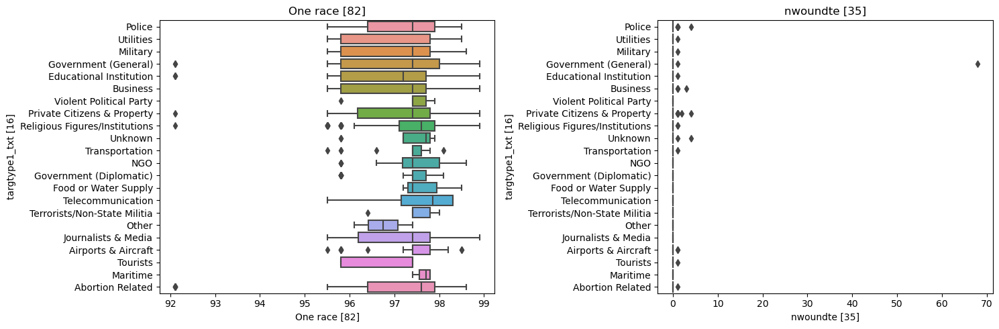

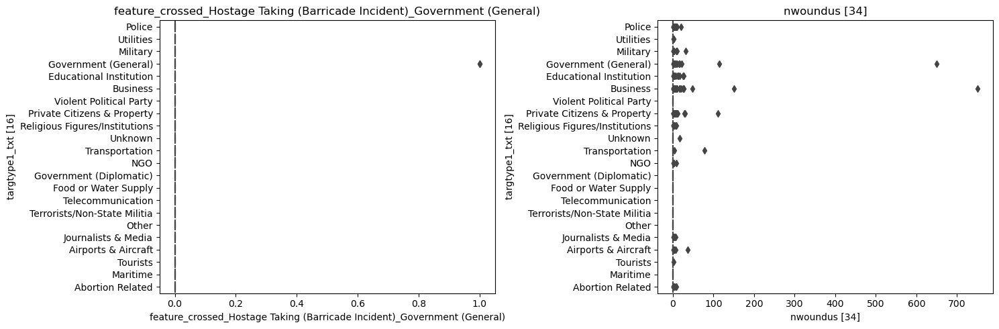

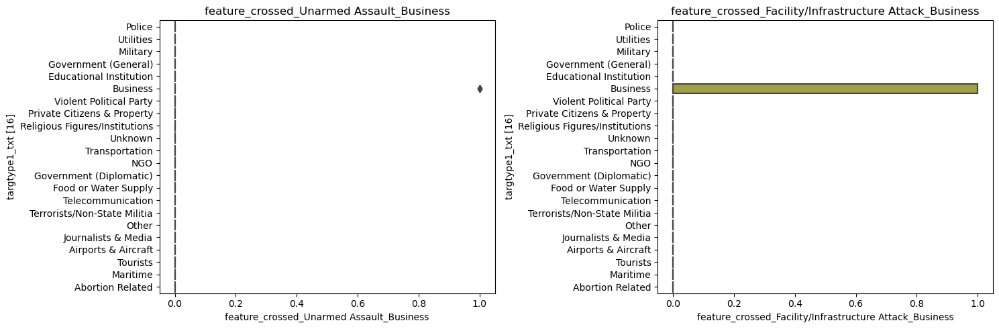

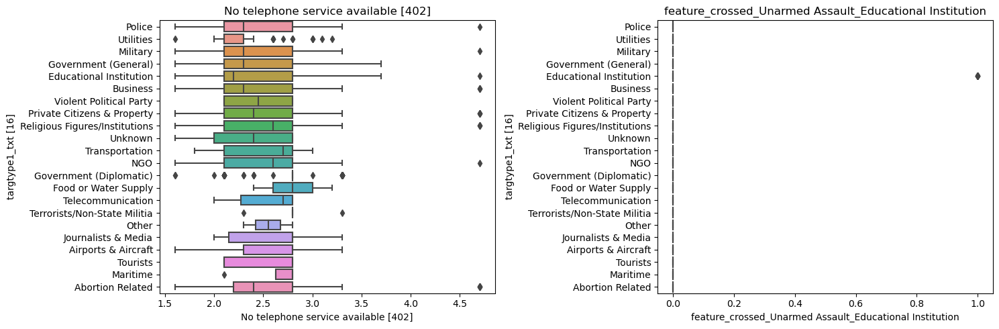

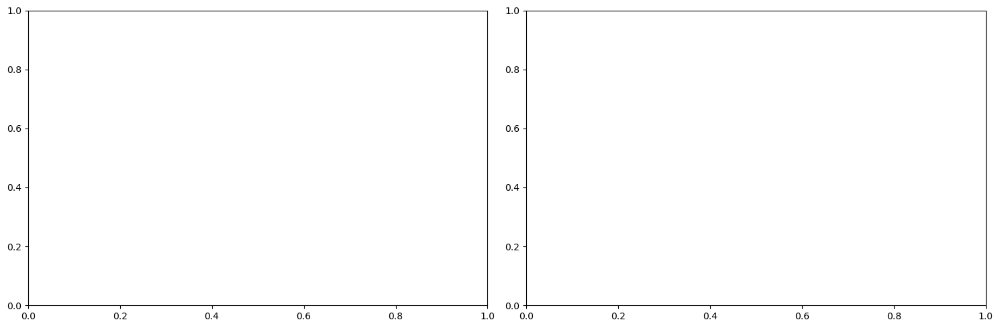

In [272]:
featurebox2(df_final, feature_iloc=51)

In [283]:
def plotbystate(df, dfbig):
    
    num_values = len(df.columns)
    num_cols = min(num_values, 3)  
    num_rows = -(-num_values // num_cols)  
    
    fig, ax = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    ax = ax.flatten()  
   
    for i, col in enumerate(df.columns):
        if pd.api.types.is_numeric_dtype(df[col]):
            xval = dfbig.iloc[:, 79]
            yval = df[col]
            sns.scatterplot(x=xval, y=yval, ax=ax[i])
            ax[i].set_title(col) 
            
            pearson_corr = dfbig[xval.name].corr(df[yval.name])
            
            if abs(pearson_corr) >= 0.25:  
                ax[i].set_facecolor('lightgreen')  
                ax[i].spines['top'].set_linewidth(2)  
                ax[i].spines['right'].set_linewidth(2)
                ax[i].spines['bottom'].set_linewidth(2)
                ax[i].spines['left'].set_linewidth(2)
            
            ax[i].set_title(f'{col} (Pearson Corr: {pearson_corr:.2f})') 
        
    for j in range(num_values, num_rows * num_cols):
        fig.delaxes(ax[j])
    
    plt.tight_layout()
    plt.show();

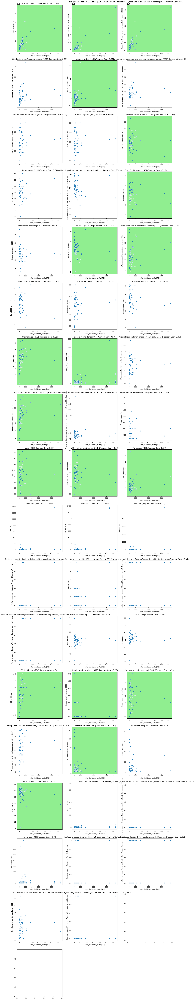

In [284]:
plotbystate(df_final, dfbig)